In [1]:
%matplotlib inline
%load_ext autoreload
%autoreload 2

In [2]:
import os
import numpy as np
import nibabel as nib
import matplotlib.pyplot as plt
import pandas as pd

from utils import load_nifti, load_masked_nifti, normalize_float

In [3]:
# Global variables
#path_to_dir = "/analysis/share/ADNI/preprocessed/" # initial preprocessing 
path_to_dir = "/analysis/share/ADNI/preprocessed_alt/" # alternative preprocessing
filename = 'INTERNAL_WARPED.nii.gz'
visit_types = ['Baseline','Month12','Month24']

In [4]:
mask = None
remove_nan = True

In [5]:
file_names = []

In [6]:
def compute_average(path_to_dir, visit_types):
    i = 0
    for subject in os.listdir(path_to_dir)[:]:
        for visit in visit_types:
            # Define full path
            path = os.path.join(path_to_dir,
                                subject,
                                visit,
                                filename)
            # Use errorhandling to load files
            try:
                if mask is None:
                    struct_arr = load_nifti(path)
                else:
                    struct_arr = load_masked_nifti(path, mask, sess, scan_pl, mask_pl)
            except FileNotFoundError:
                print('Image not Found:', path, i)
            if remove_nan:
                struct_arr[np.where(np.isnan(struct_arr))] = 0

            # Squash between 0 and 1
            struct_arr = normalize_float(struct_arr, min=0.)
            struct_arr = struct_arr.numpy()

            # Store names and scan data
            file_names.append(os.path.join(subject, visit))
            data[i] = struct_arr
            i += 1
    return np.mean(data, axis=0)

In [106]:
def compute_norms(avg_scan, thresh, z_slice=45):
    total_norm = 0
    fail_count = 0
    for idx, sample in enumerate(data[:]):
        # Squash between 0 and 1
        struct_arr = normalize_float(sample, min=0.)
        struct_arr = struct_arr.numpy()

        # Show image slices
        plt.figure(figsize=(10, 8))
        plt.subplot(1, 3, 1)
        plt.imshow(np.fliplr(struct_arr[:,:,z_slice]).T, cmap='gray')
        plt.subplot(1, 3, 2)
        plt.imshow(np.flip(struct_arr, axis=2)[:,z_slice,:].T, cmap='gray')
        plt.subplot(1, 3, 3)
        plt.imshow(np.fliplr(struct_arr[z_slice,:,:]).T, cmap='gray')

        # Compute norm between average and scan
        norm = np.linalg.norm(struct_arr - avg_scan, ord='fro', axis=(0,1))
        scan_norm = np.sum(norm)
        print(file_names[idx], 'Distance from average:', scan_norm, end=' ')

        # Test if norm is larger than threshold
        if(scan_norm > thresh):
            print('###')
            fail_count += 1
            plt.title('Fail')
        else:
            plt.title('No Fail')
            print()
        total_norm += scan_norm
        plt.show()
    print("Total failure count", fail_count)
    

In [21]:
# Load scans and compute average scan
#data = np.zeros(shape=(89*3, 91, 109, 91)) # for /preprocessed/
data = np.zeros(shape=(89*3, 193, 229, 193)) # for /preprocssed_alt/

print("Calculating average scan..")
avg_scan = compute_average(path_to_dir, visit_types)

Calculating average scan..
Image not Found: /analysis/share/ADNI/preprocessed_alt/037_S_0501/Month12/INTERNAL_WARPED.nii.gz 16
Image not Found: /analysis/share/ADNI/preprocessed_alt/027_S_1387/Month24/INTERNAL_WARPED.nii.gz 116


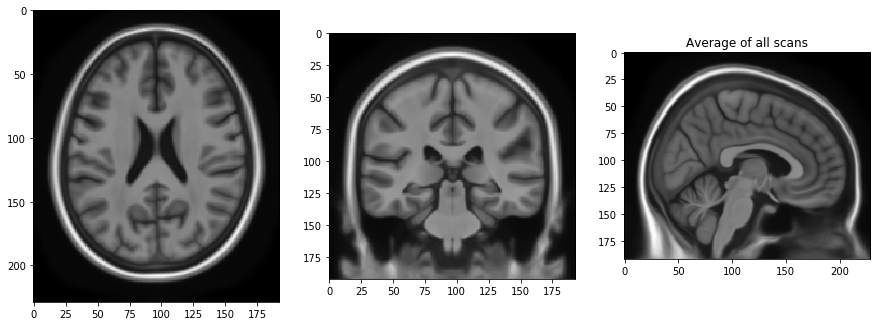

In [113]:
# Show average slices
z_slice = 100
plt.figure(figsize=(15, 10))

plt.subplot(1, 3, 1)
plt.imshow(np.fliplr(avg_scan[:,:,z_slice]).T, cmap='gray')
plt.subplot(1, 3, 2)
plt.imshow(np.flip(avg_scan, axis=2)[:,z_slice,:].T, cmap='gray')
plt.subplot(1, 3, 3)
plt.imshow(np.fliplr(avg_scan[z_slice,:,:]).T, cmap='gray')
plt.title('Average of all scans')
plt.show()

Calculating scan norms..
136_S_1227/Baseline Distance from template: 1516.9574972 


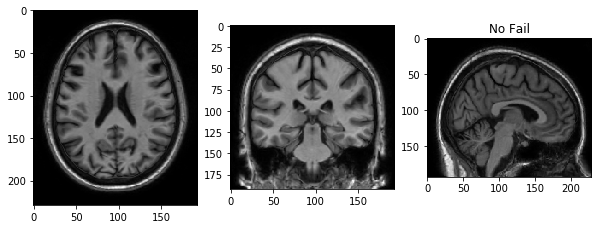

136_S_1227/Month12 Distance from template: 1628.97762469 


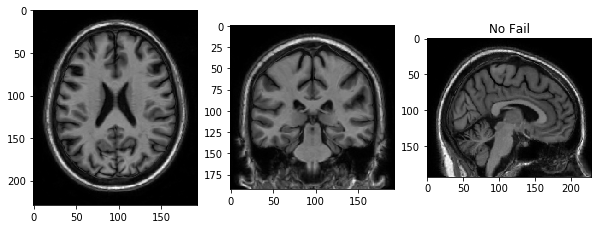

136_S_1227/Month24 Distance from template: 2317.58843103 


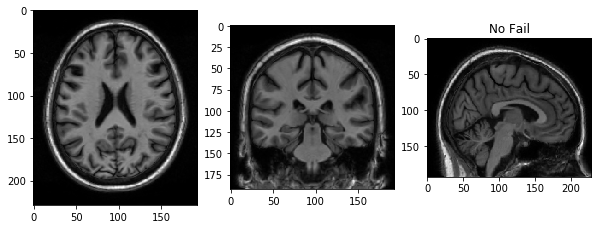

136_S_0196/Baseline Distance from template: 1868.43147438 


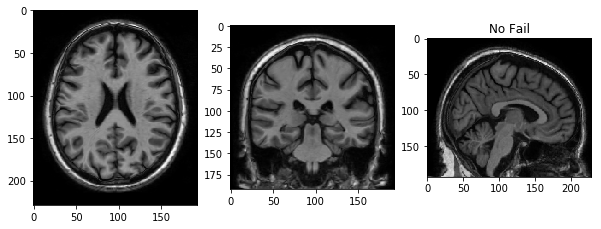

136_S_0196/Month12 Distance from template: 1941.2112698 


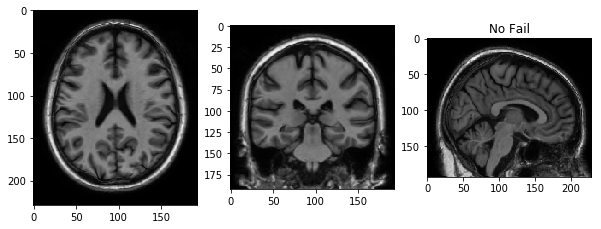

136_S_0196/Month24 Distance from template: 2392.02436493 


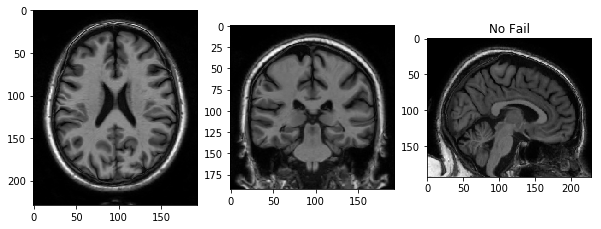

053_S_0507/Baseline Distance from template: 1874.60395589 


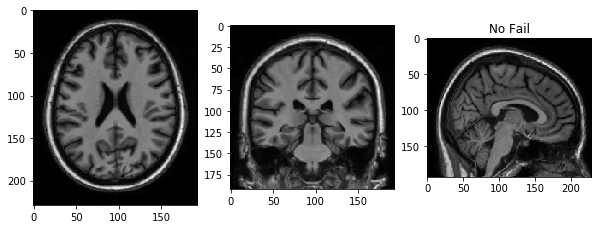

053_S_0507/Month12 Distance from template: 1998.22920677 


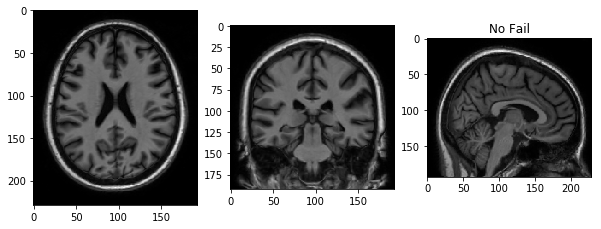

053_S_0507/Month24 Distance from template: 1792.69337928 


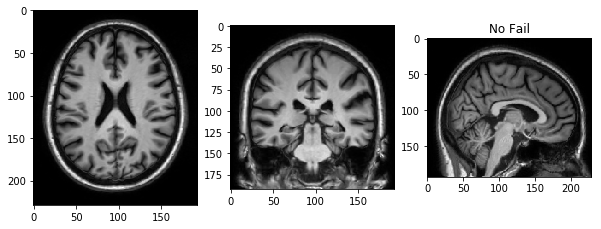

018_S_0425/Baseline Distance from template: 2435.14379908 


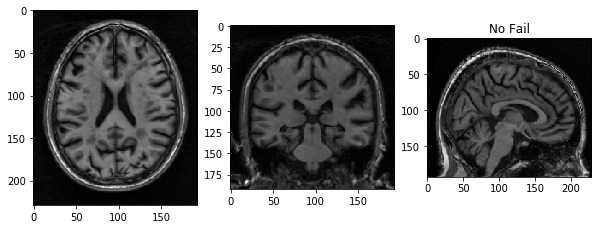

018_S_0425/Month12 Distance from template: 1845.89331525 


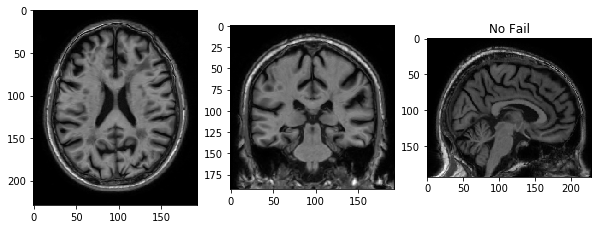

018_S_0425/Month24 Distance from template: 1790.93605216 


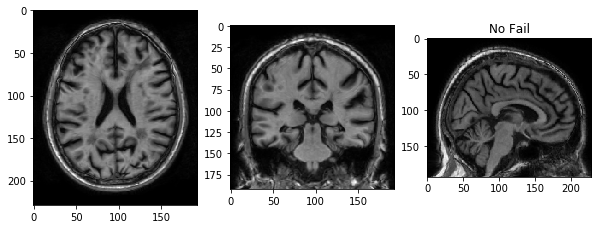

023_S_1046/Baseline Distance from template: 1489.15033018 


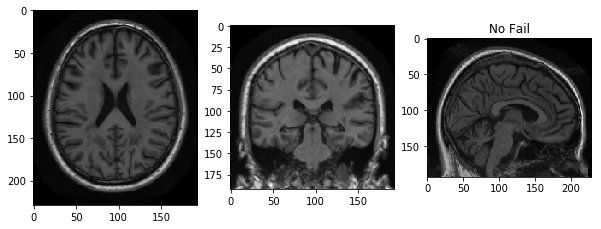

023_S_1046/Month12 Distance from template: 1717.37510777 


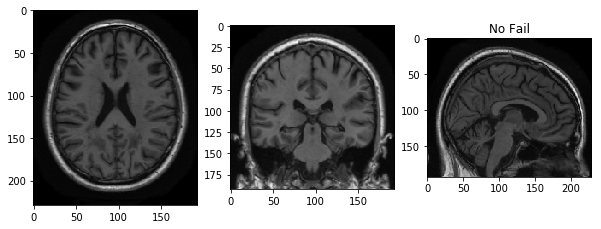

023_S_1046/Month24 Distance from template: 1804.10705771 


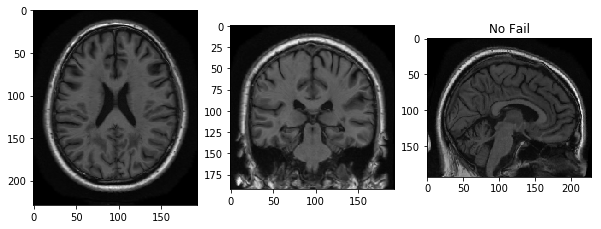

037_S_0501/Baseline Distance from template: 4531.79189199 ###


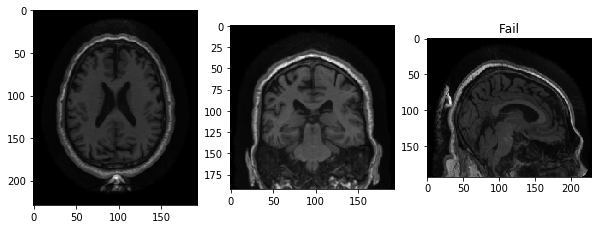

037_S_0501/Month12 Distance from template: 4531.79189199 ###


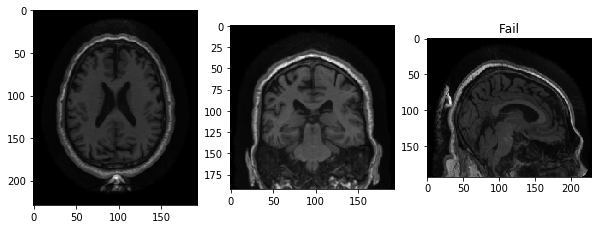

037_S_0501/Month24 Distance from template: 3862.84536517 ###


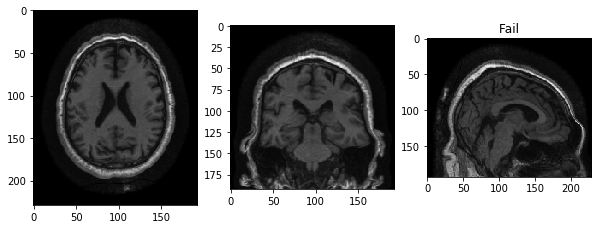

051_S_1123/Baseline Distance from template: 4296.16834295 ###


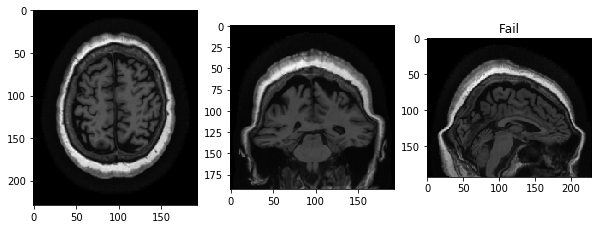

051_S_1123/Month12 Distance from template: 3777.21419797 ###


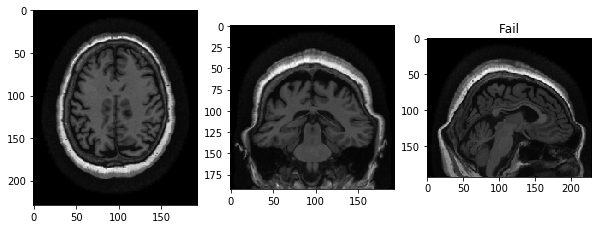

051_S_1123/Month24 Distance from template: 3710.10570374 ###


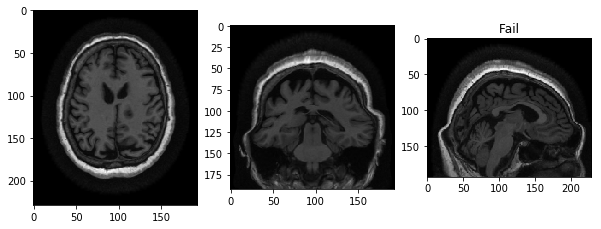

002_S_0729/Baseline Distance from template: 2859.53417476 ###


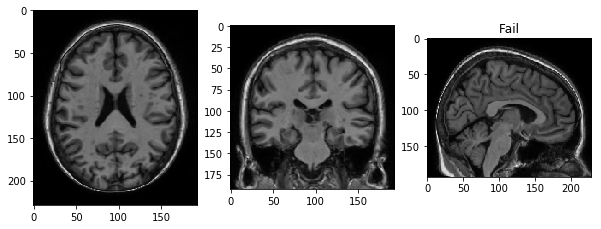

002_S_0729/Month12 Distance from template: 1774.84323207 


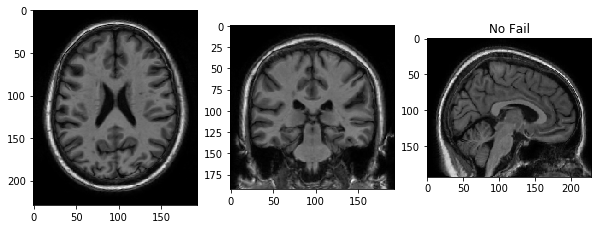

002_S_0729/Month24 Distance from template: 1623.3712027 


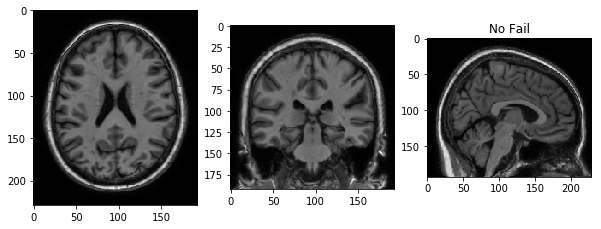

016_S_1326/Baseline Distance from template: 1594.11764223 


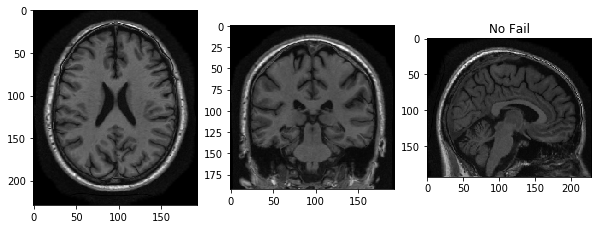

016_S_1326/Month12 Distance from template: 1583.64348572 


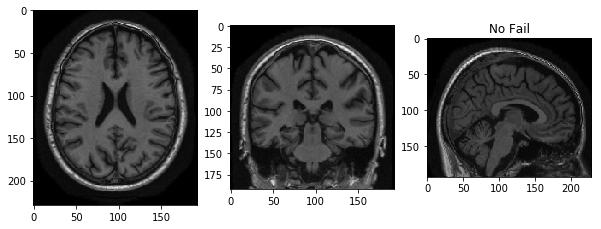

016_S_1326/Month24 Distance from template: 1802.74508878 


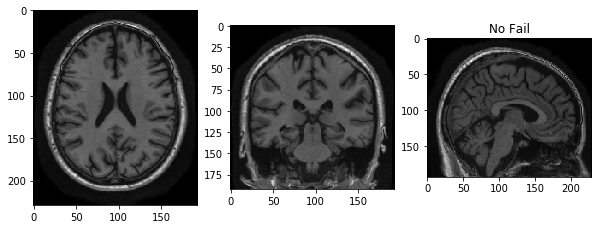

023_S_0031/Baseline Distance from template: 2828.44022562 ###


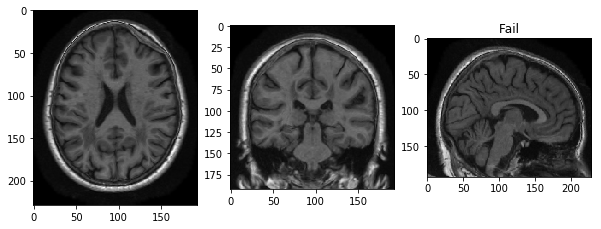

023_S_0031/Month12 Distance from template: 2343.86962406 


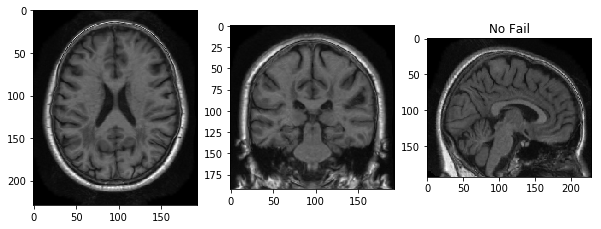

023_S_0031/Month24 Distance from template: 2464.33072544 


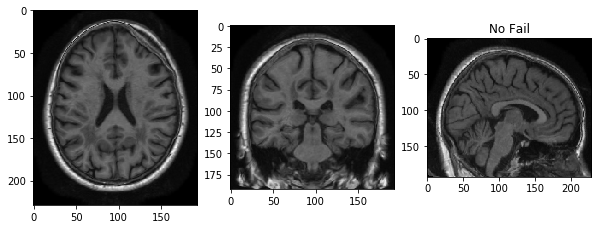

067_S_0290/Baseline Distance from template: 1631.05626128 


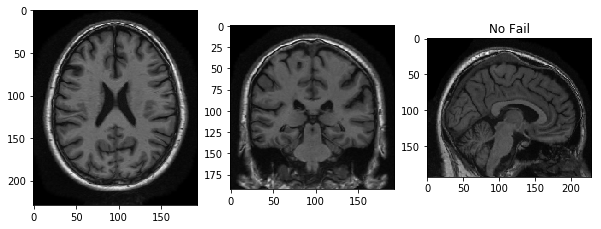

067_S_0290/Month12 Distance from template: 2199.57718691 


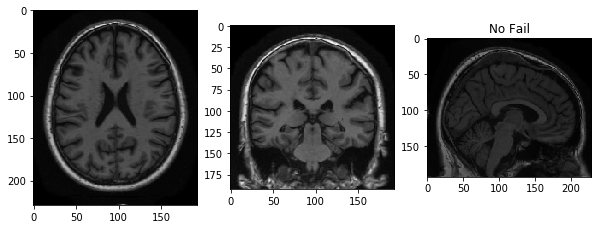

067_S_0290/Month24 Distance from template: 1809.95540588 


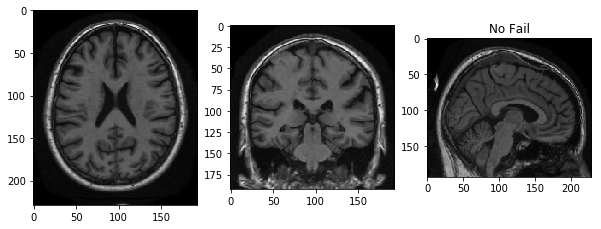

016_S_1117/Baseline Distance from template: 2194.32656608 


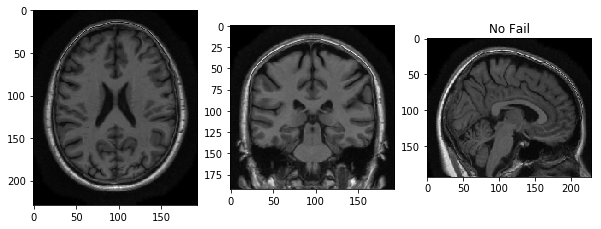

016_S_1117/Month12 Distance from template: 1975.73931587 


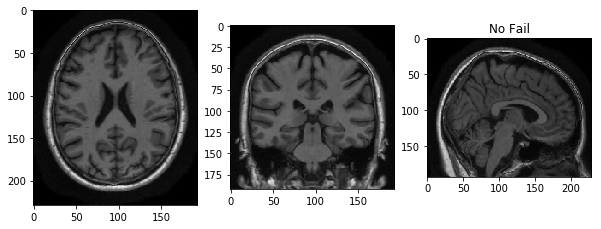

016_S_1117/Month24 Distance from template: 2552.25563539 


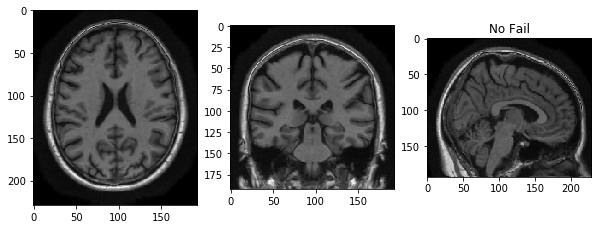

023_S_0926/Baseline Distance from template: 2764.55112743 ###


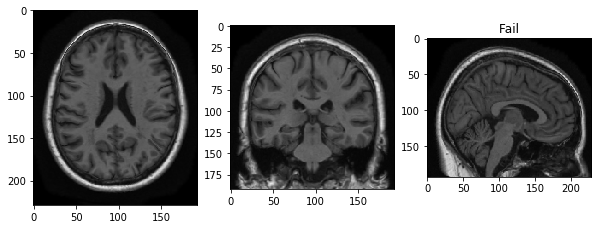

023_S_0926/Month12 Distance from template: 2510.82205771 


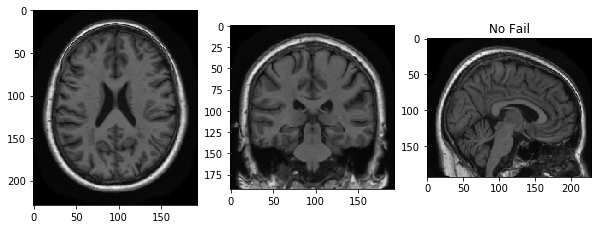

023_S_0926/Month24 Distance from template: 2931.63277691 ###


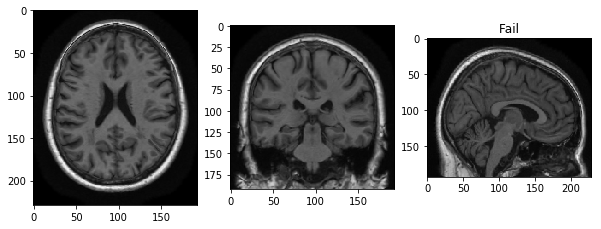

136_S_0426/Baseline Distance from template: 2032.19425073 


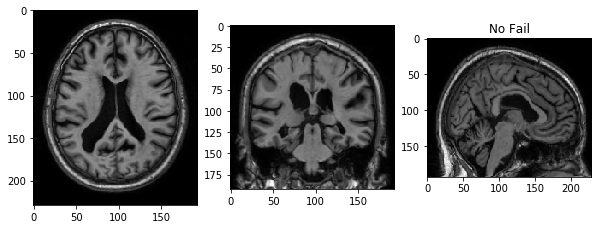

136_S_0426/Month12 Distance from template: 2007.24129907 


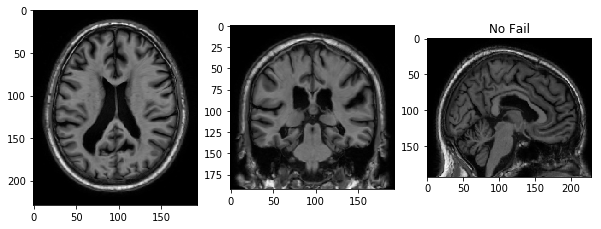

136_S_0426/Month24 Distance from template: 1995.0409188 


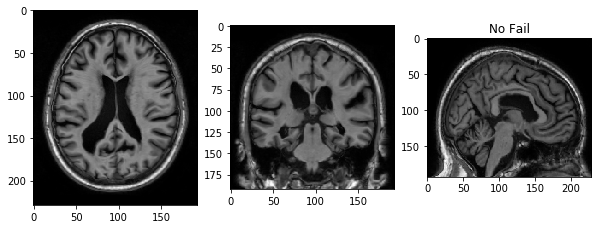

023_S_0963/Baseline Distance from template: 1782.44248149 


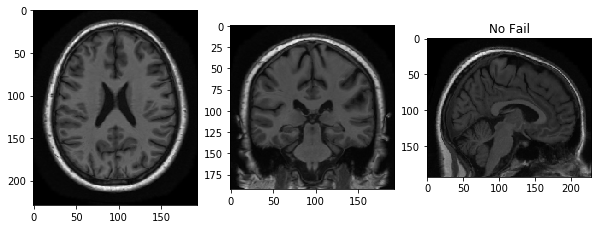

023_S_0963/Month12 Distance from template: 2034.5838589 


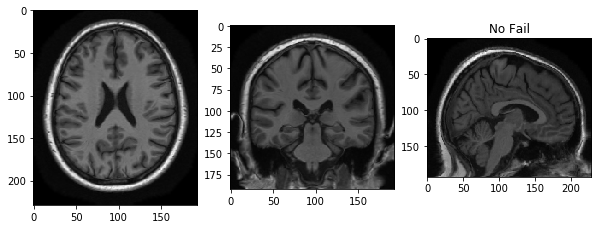

023_S_0963/Month24 Distance from template: 2061.00153869 


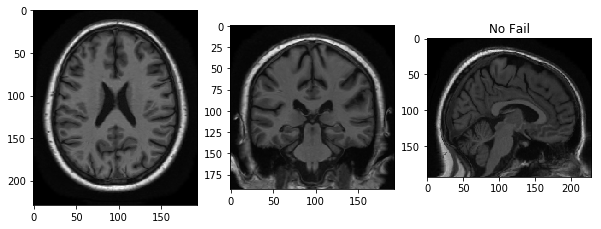

031_S_1209/Baseline Distance from template: 2250.1028949 


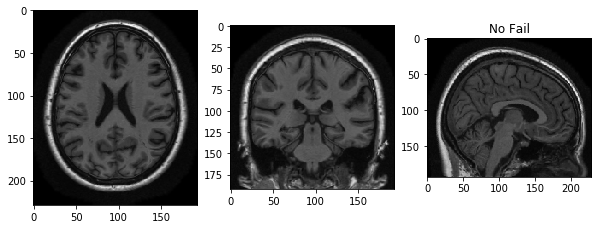

031_S_1209/Month12 Distance from template: 2249.25583876 


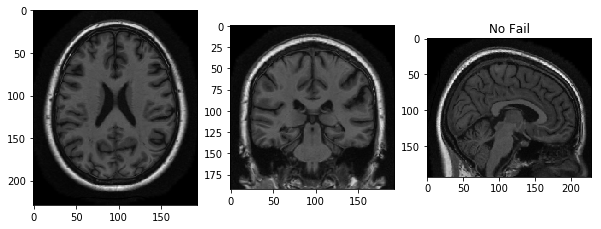

031_S_1209/Month24 Distance from template: 2125.33177065 


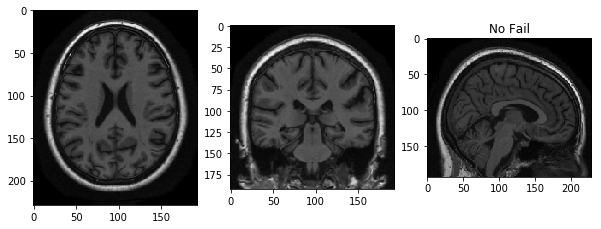

023_S_1190/Baseline Distance from template: 2049.15052396 


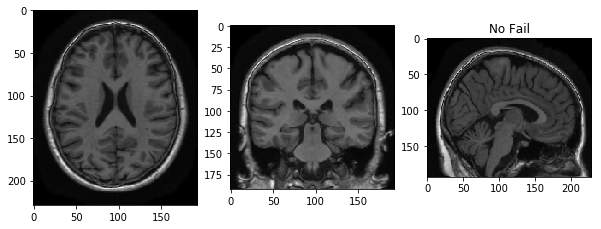

023_S_1190/Month12 Distance from template: 2237.45231126 


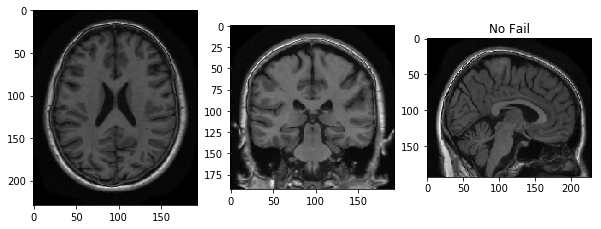

023_S_1190/Month24 Distance from template: 1870.96352515 


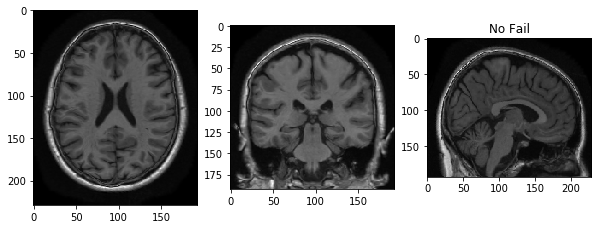

002_S_1280/Baseline Distance from template: 2319.39753792 


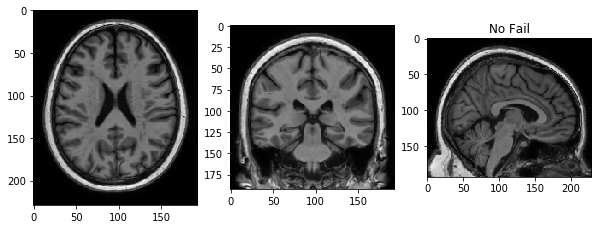

002_S_1280/Month12 Distance from template: 2436.24067681 


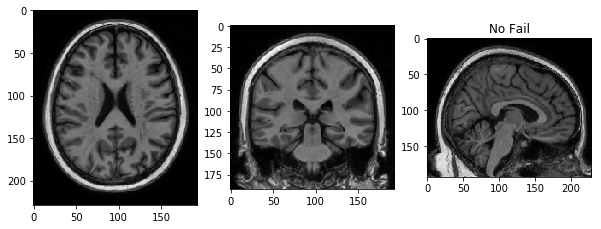

002_S_1280/Month24 Distance from template: 2391.53149047 


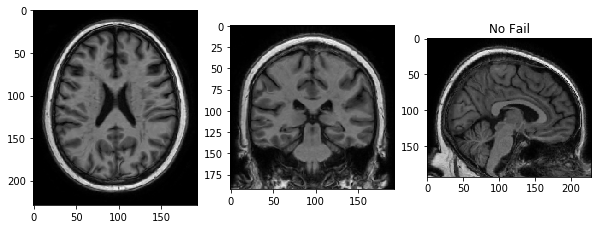

023_S_0058/Baseline Distance from template: 2412.31328103 


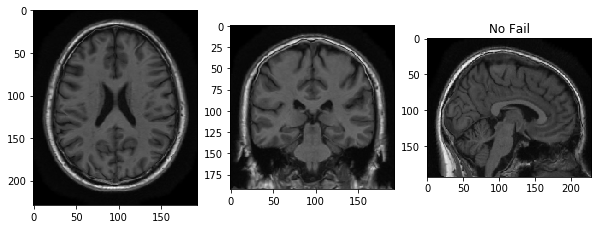

023_S_0058/Month12 Distance from template: 2367.85626518 


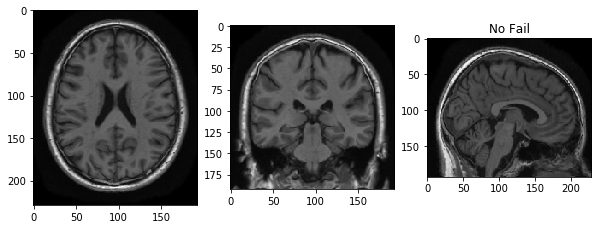

023_S_0058/Month24 Distance from template: 2589.96194788 


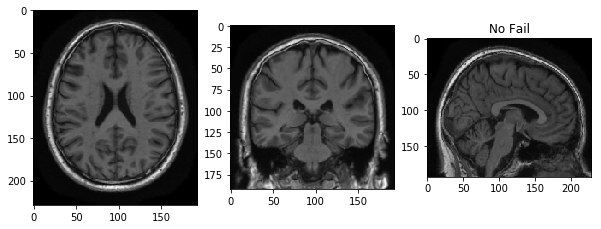

116_S_0649/Baseline Distance from template: 2037.844963 


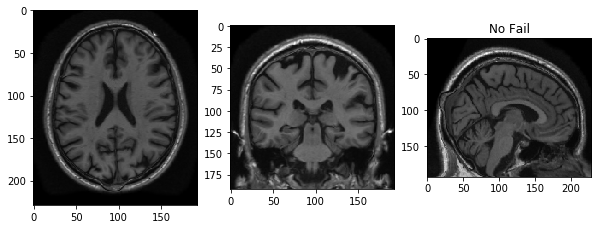

116_S_0649/Month12 Distance from template: 3912.81377131 ###


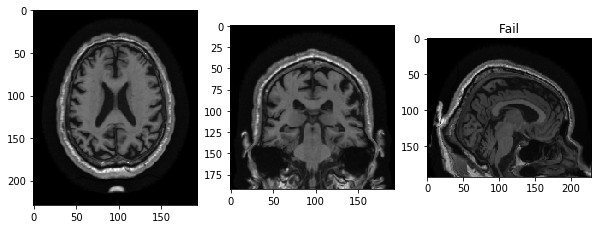

116_S_0649/Month24 Distance from template: 4102.43926578 ###


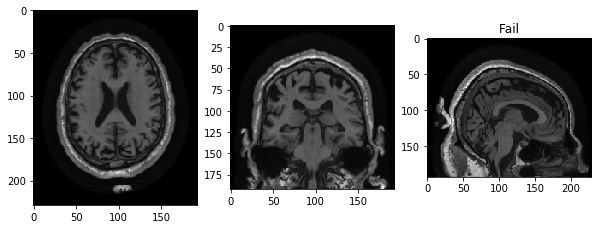

005_S_0448/Baseline Distance from template: 2907.74025872 ###


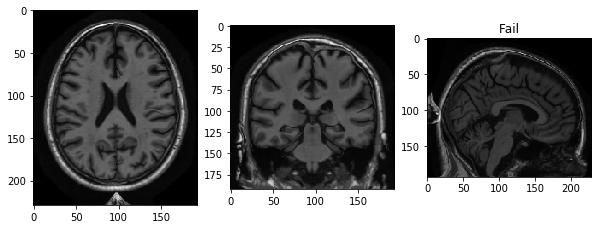

005_S_0448/Month12 Distance from template: 1892.96385144 


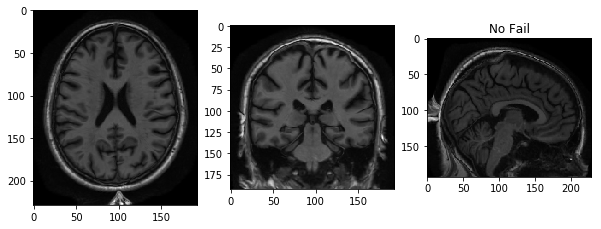

005_S_0448/Month24 Distance from template: 2284.83197751 


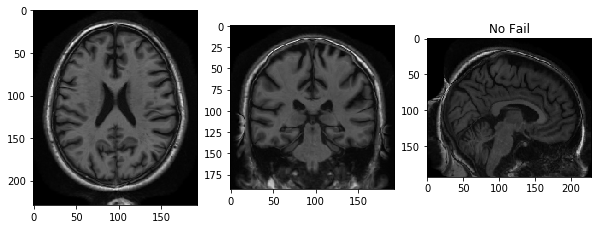

007_S_1206/Baseline Distance from template: 1690.25770485 


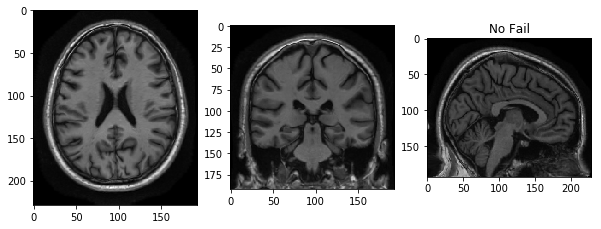

007_S_1206/Month12 Distance from template: 1831.52987059 


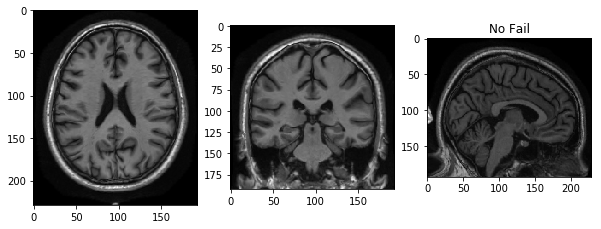

007_S_1206/Month24 Distance from template: 2338.0007484 


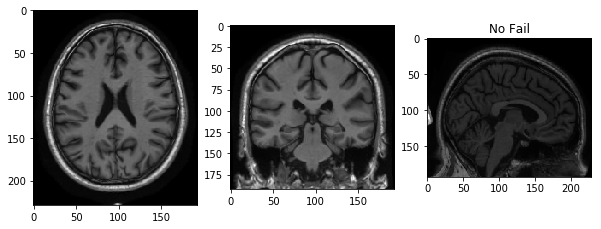

027_S_0835/Baseline Distance from template: 1988.90616382 


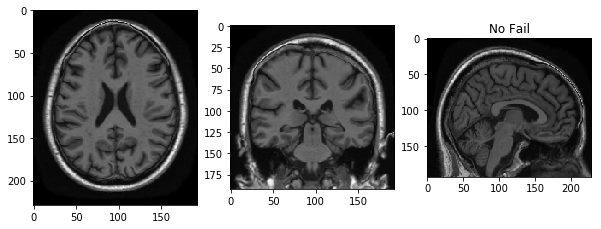

027_S_0835/Month12 Distance from template: 2118.19603839 


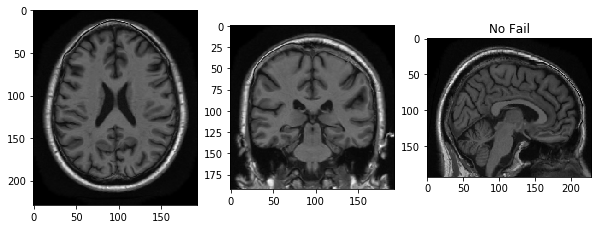

027_S_0835/Month24 Distance from template: 2365.13047539 


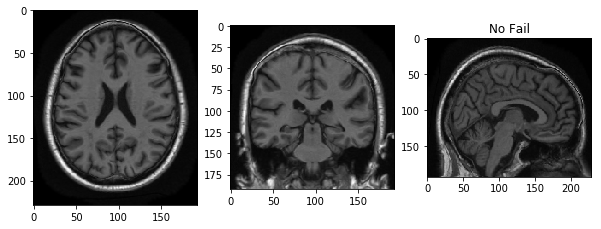

136_S_0195/Baseline Distance from template: 2270.38586582 


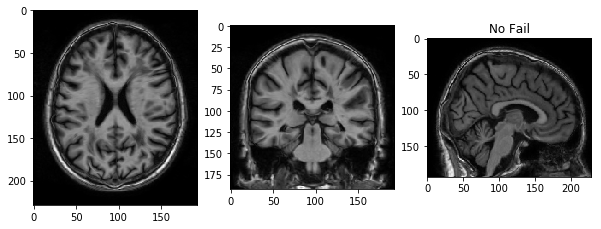

136_S_0195/Month12 Distance from template: 2540.15307906 


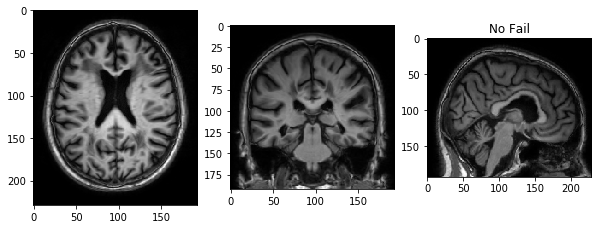

136_S_0195/Month24 Distance from template: 2205.28695876 


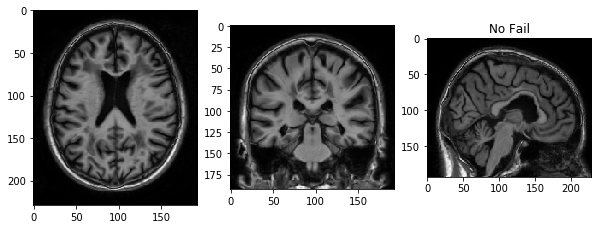

100_S_0190/Baseline Distance from template: 1662.38055582 


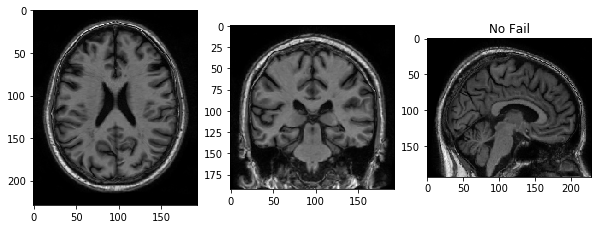

100_S_0190/Month12 Distance from template: 1720.17827877 


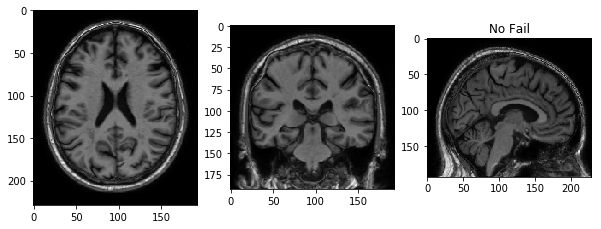

100_S_0190/Month24 Distance from template: 1887.63638491 


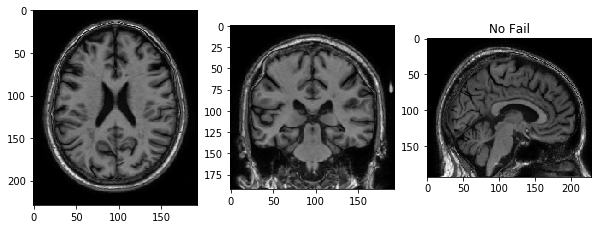

136_S_0579/Baseline Distance from template: 1723.10157153 


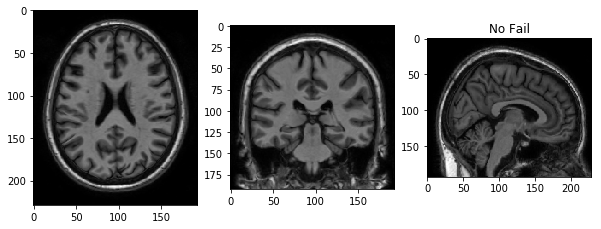

136_S_0579/Month12 Distance from template: 1327.35975473 


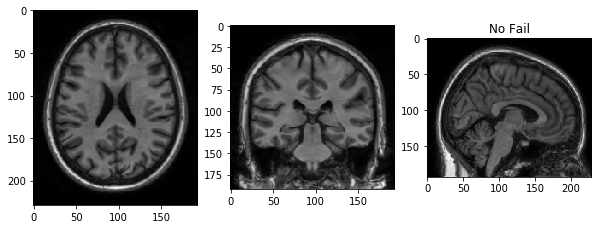

136_S_0579/Month24 Distance from template: 2198.22121136 


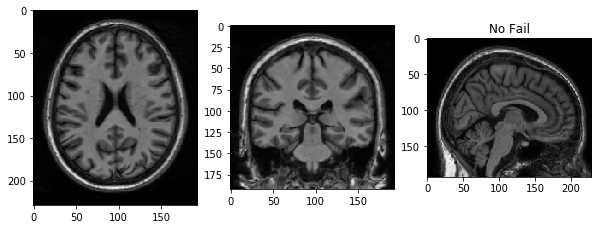

023_S_1126/Baseline Distance from template: 1741.90052182 


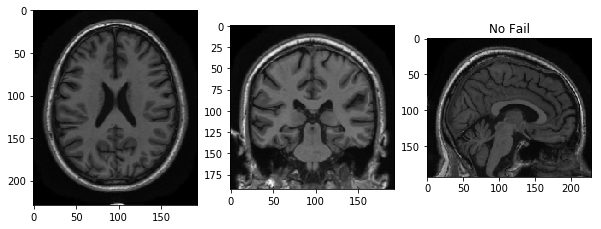

023_S_1126/Month12 Distance from template: 1838.12844594 


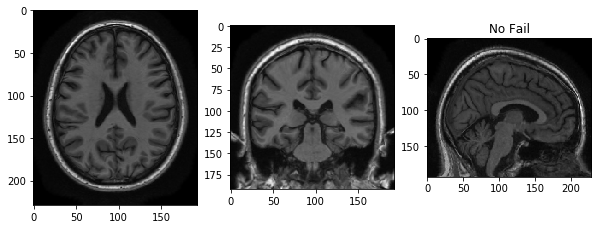

023_S_1126/Month24 Distance from template: 1929.02879939 


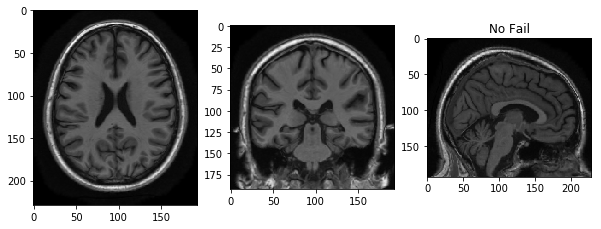

002_S_0559/Baseline Distance from template: 1941.90623222 


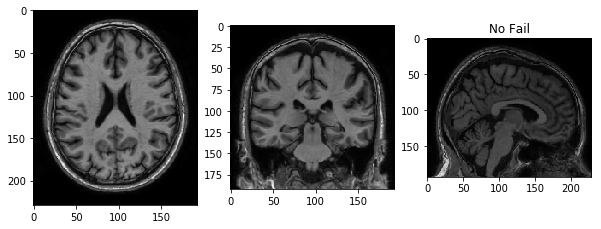

002_S_0559/Month12 Distance from template: 1843.6795655 


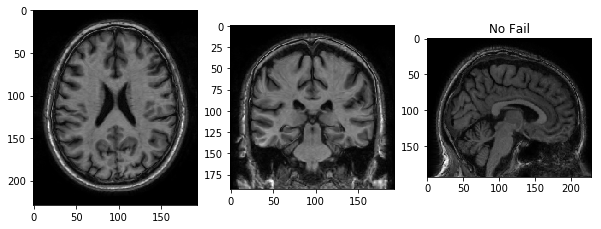

002_S_0559/Month24 Distance from template: 2135.20354747 


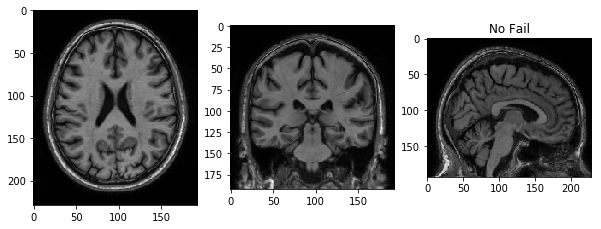

116_S_1232/Baseline Distance from template: 3852.02658021 ###


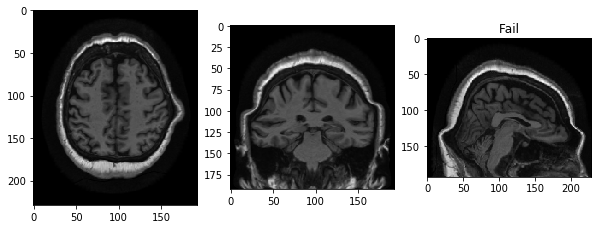

116_S_1232/Month12 Distance from template: 1752.36573179 


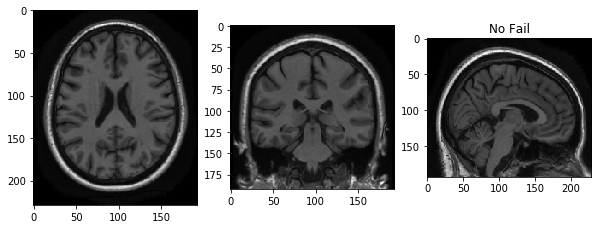

116_S_1232/Month24 Distance from template: 2103.00219903 


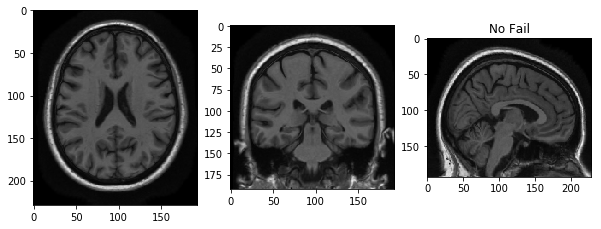

016_S_1121/Baseline Distance from template: 2521.68880155 


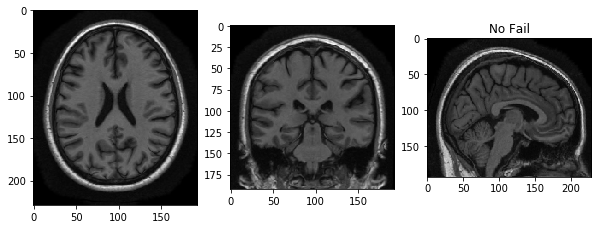

016_S_1121/Month12 Distance from template: 2069.51850296 


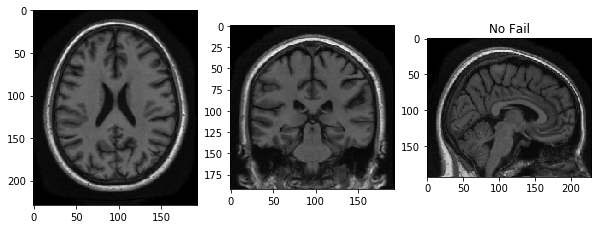

016_S_1121/Month24 Distance from template: 2045.56913105 


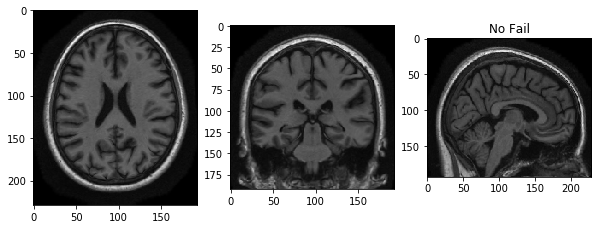

023_S_0331/Baseline Distance from template: 2114.25956589 


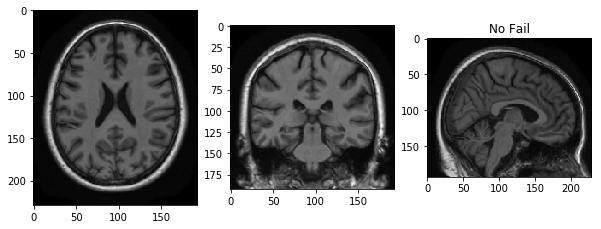

023_S_0331/Month12 Distance from template: 2320.29541508 


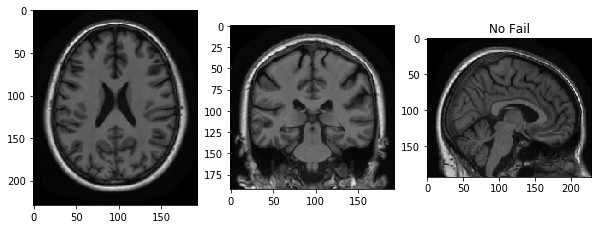

023_S_0331/Month24 Distance from template: 2310.03108701 


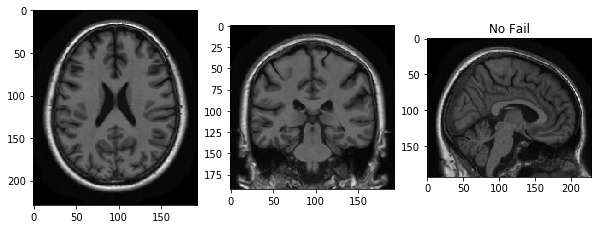

127_S_0260/Baseline Distance from template: 2161.83665306 


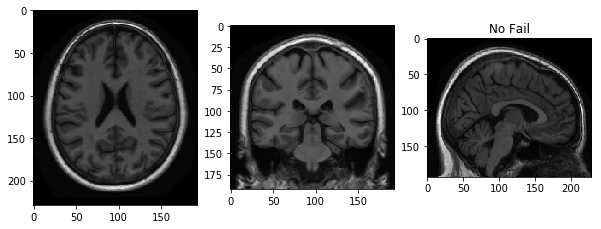

127_S_0260/Month12 Distance from template: 2317.75446682 


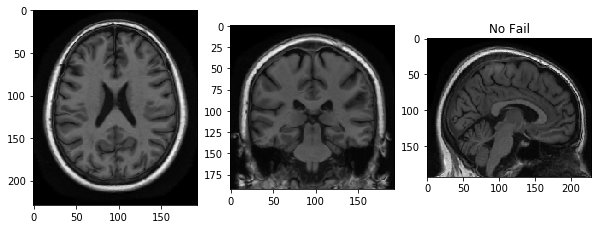

127_S_0260/Month24 Distance from template: 2419.12534106 


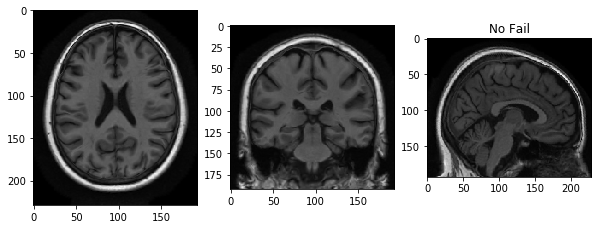

027_S_0307/Baseline Distance from template: 1868.56192835 


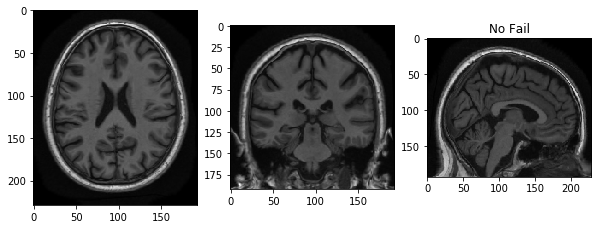

027_S_0307/Month12 Distance from template: 1715.45434108 


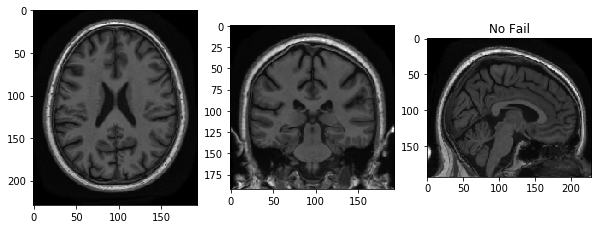

027_S_0307/Month24 Distance from template: 1597.99067186 


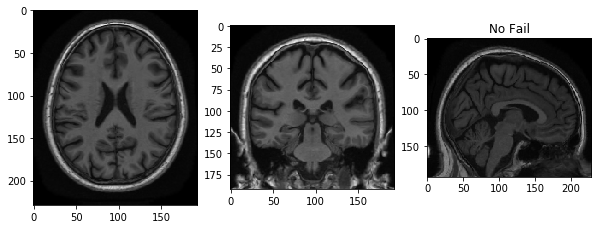

005_S_0324/Baseline Distance from template: 1448.13726363 


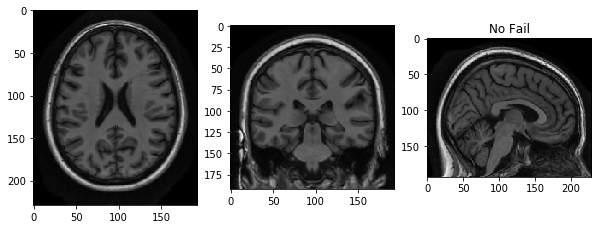

005_S_0324/Month12 Distance from template: 1684.73515503 


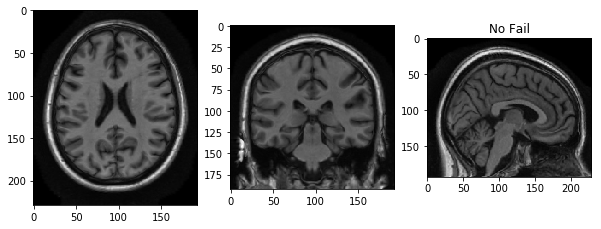

005_S_0324/Month24 Distance from template: 1495.50165969 


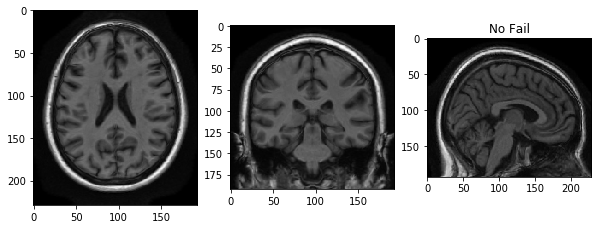

002_S_1070/Baseline Distance from template: 2237.00602924 


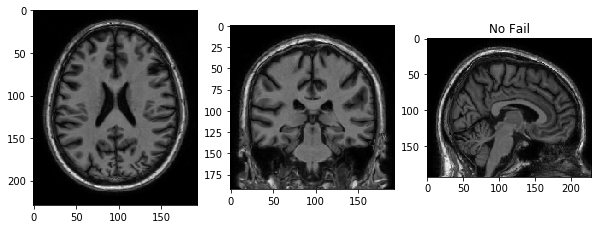

002_S_1070/Month12 Distance from template: 1974.92539295 


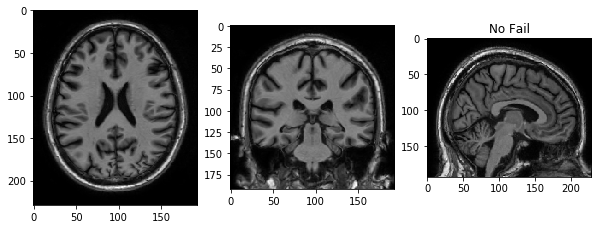

002_S_1070/Month24 Distance from template: 1746.39385934 


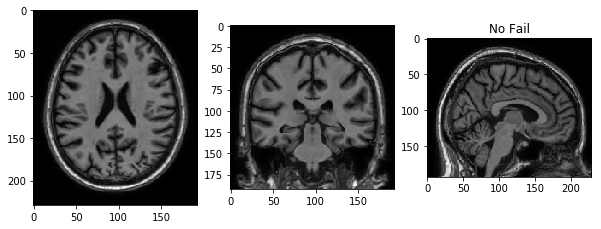

032_S_0677/Baseline Distance from template: 1860.26403983 


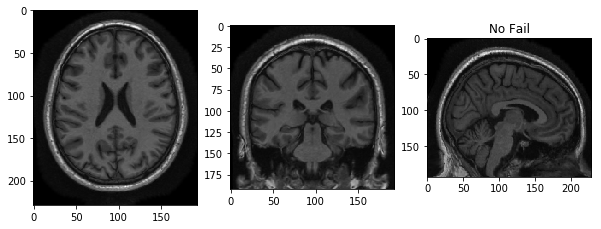

032_S_0677/Month12 Distance from template: 2171.45591276 


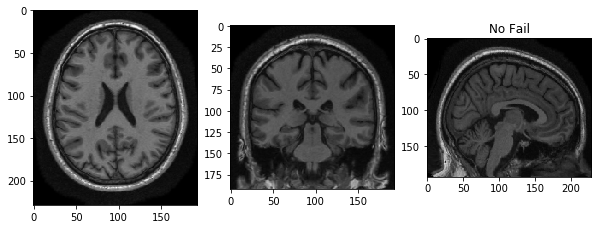

032_S_0677/Month24 Distance from template: 2129.10287259 


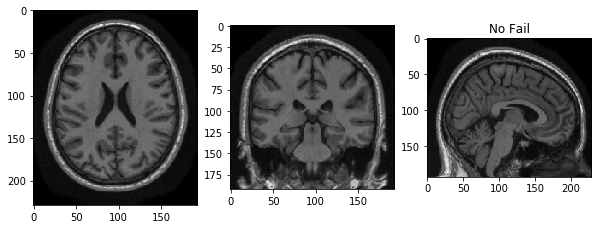

136_S_0086/Baseline Distance from template: 1691.79974518 


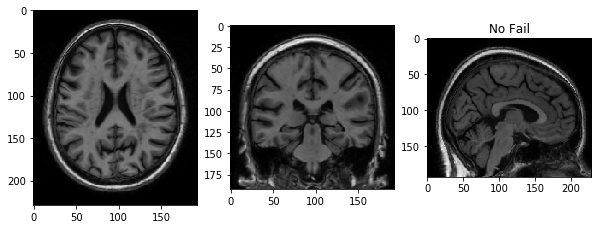

136_S_0086/Month12 Distance from template: 1740.03994588 


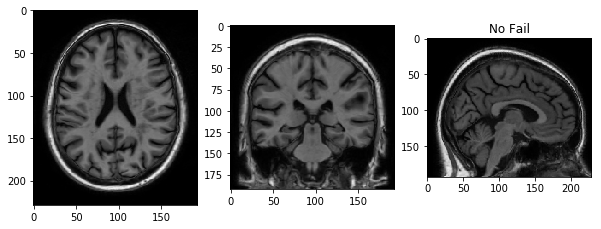

136_S_0086/Month24 Distance from template: 1636.34846316 


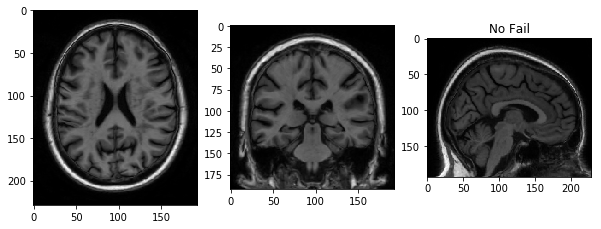

130_S_0886/Baseline Distance from template: 2373.94635349 


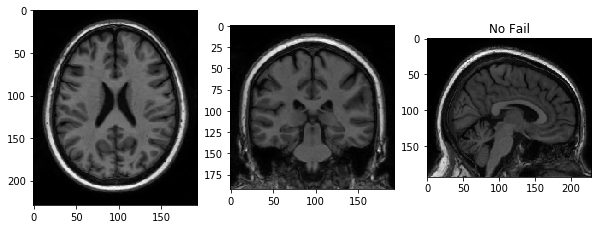

130_S_0886/Month12 Distance from template: 1992.13207925 


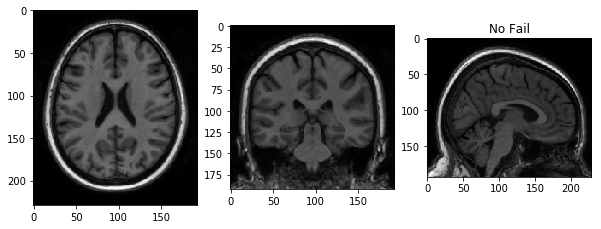

130_S_0886/Month24 Distance from template: 1757.96312741 


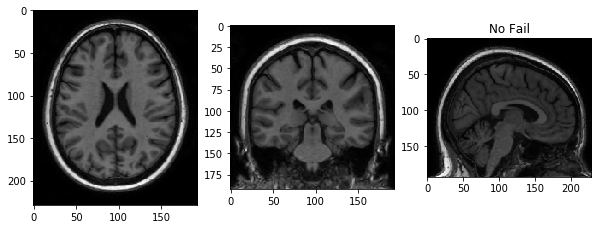

027_S_1387/Baseline Distance from template: 3907.67806834 ###


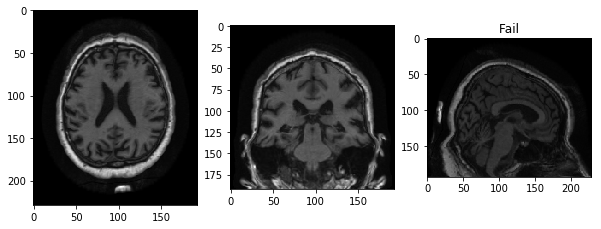

027_S_1387/Month12 Distance from template: 3068.70221147 ###


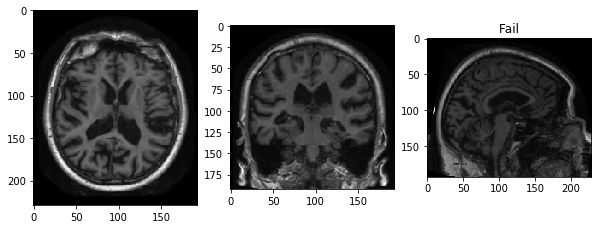

027_S_1387/Month24 Distance from template: 3068.70221147 ###


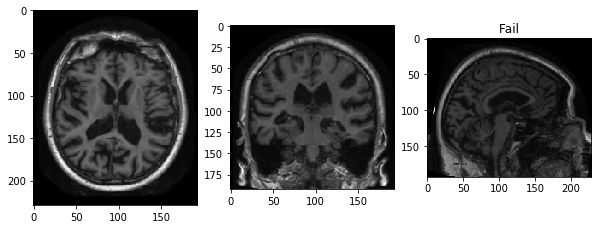

037_S_0303/Baseline Distance from template: 1621.68063207 


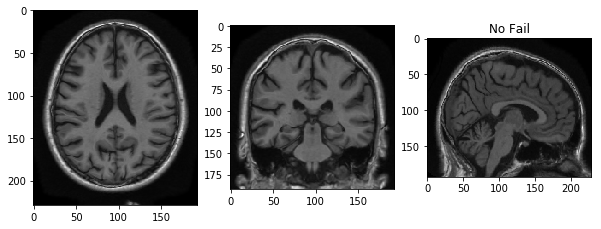

037_S_0303/Month12 Distance from template: 2118.48524545 


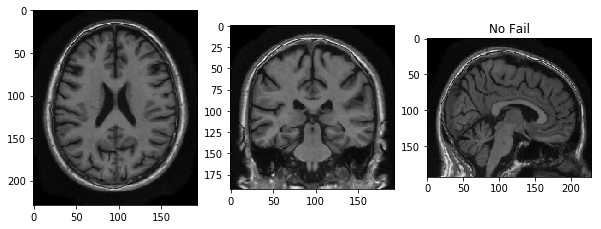

037_S_0303/Month24 Distance from template: 1567.48469337 


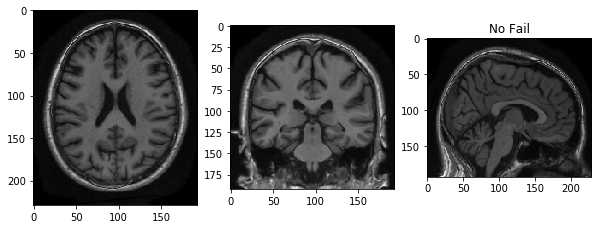

012_S_1009/Baseline Distance from template: 1796.32009537 


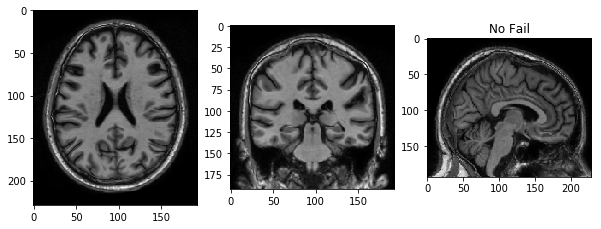

012_S_1009/Month12 Distance from template: 1872.6567917 


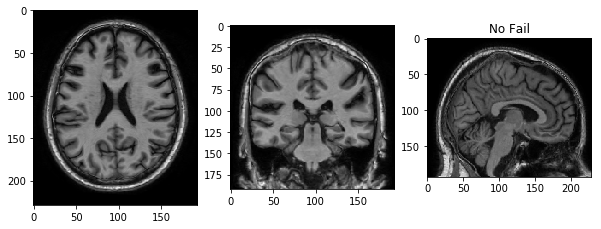

012_S_1009/Month24 Distance from template: 1806.75256571 


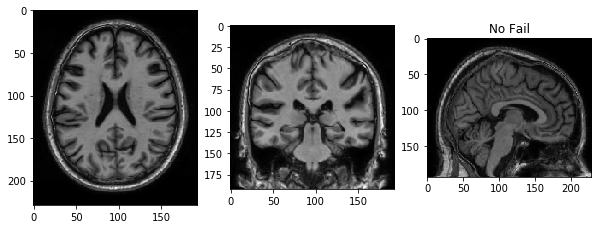

031_S_0830/Baseline Distance from template: 2287.75189858 


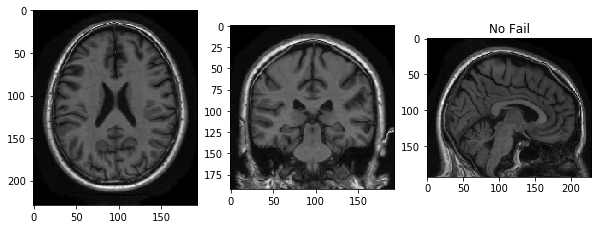

031_S_0830/Month12 Distance from template: 2341.45683204 


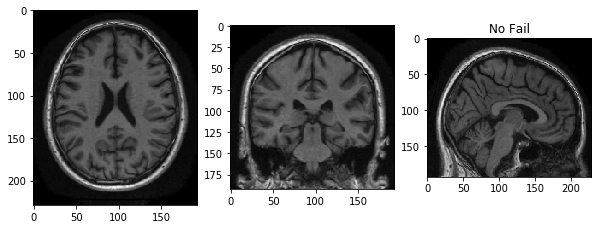

031_S_0830/Month24 Distance from template: 1838.6726049 


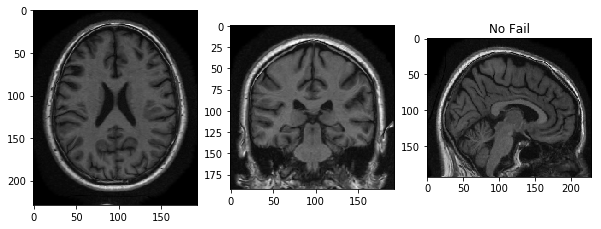

023_S_0061/Baseline Distance from template: 1673.0478842 


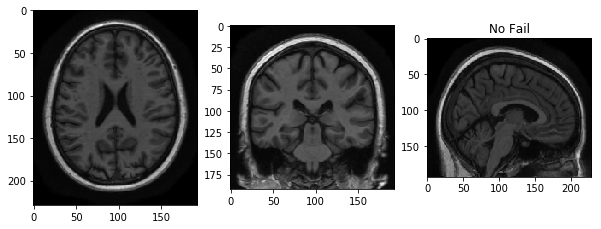

023_S_0061/Month12 Distance from template: 2087.88688473 


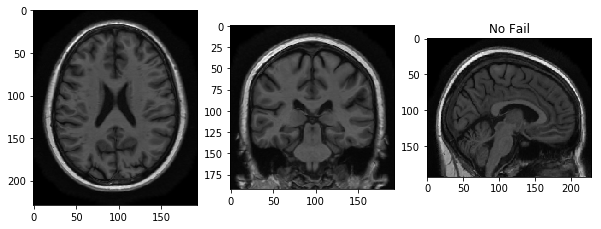

023_S_0061/Month24 Distance from template: 2304.81854456 


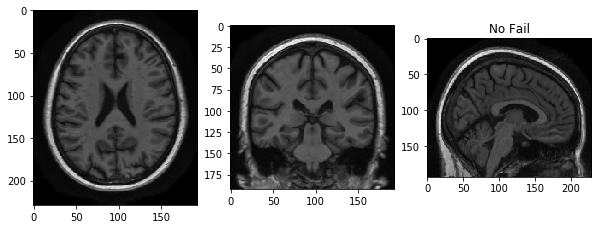

130_S_0505/Baseline Distance from template: 1956.3740878 


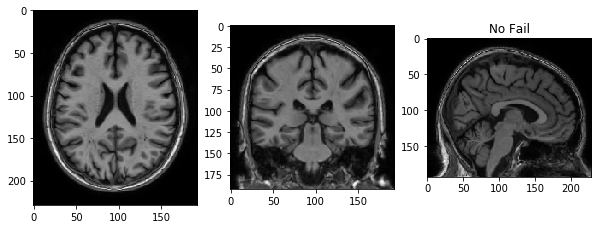

130_S_0505/Month12 Distance from template: 2039.2961488 


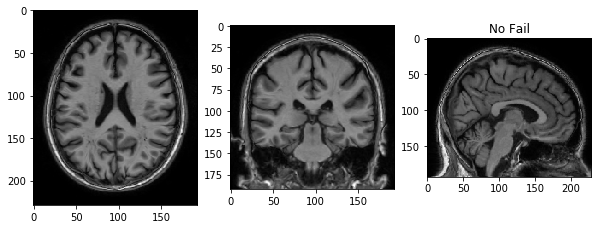

130_S_0505/Month24 Distance from template: 2061.80170612 


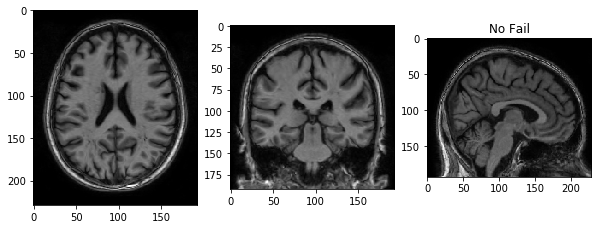

127_S_0622/Baseline Distance from template: 1506.54564693 


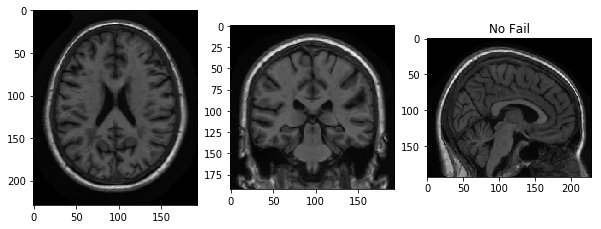

127_S_0622/Month12 Distance from template: 1501.02233825 


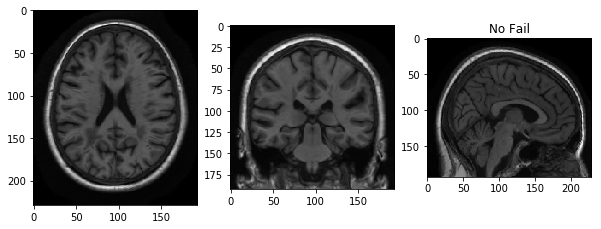

127_S_0622/Month24 Distance from template: 1891.02675326 


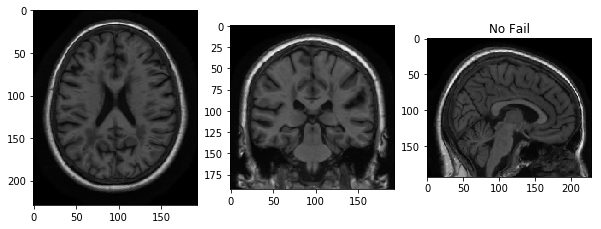

127_S_0844/Baseline Distance from template: 2139.11532433 


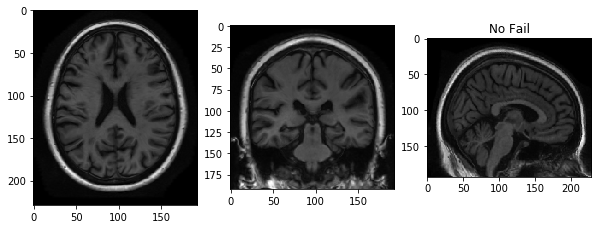

127_S_0844/Month12 Distance from template: 1914.26221025 


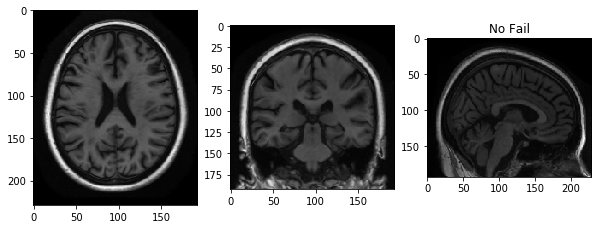

127_S_0844/Month24 Distance from template: 1976.28306525 


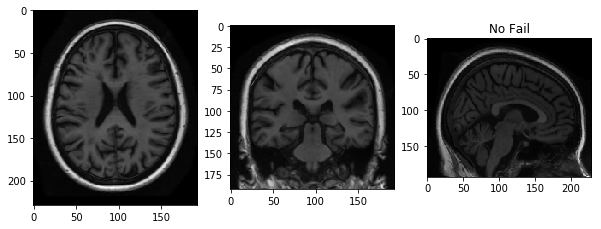

116_S_0382/Baseline Distance from template: 3674.76385437 ###


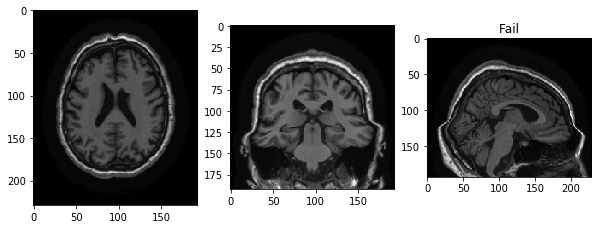

116_S_0382/Month12 Distance from template: 2080.18668744 


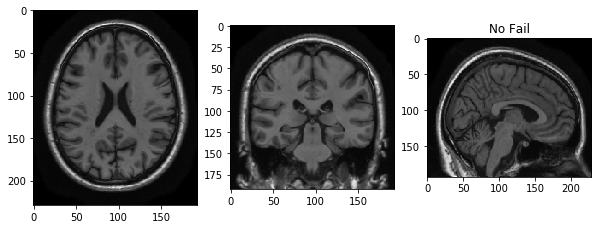

116_S_0382/Month24 Distance from template: 2002.44464854 


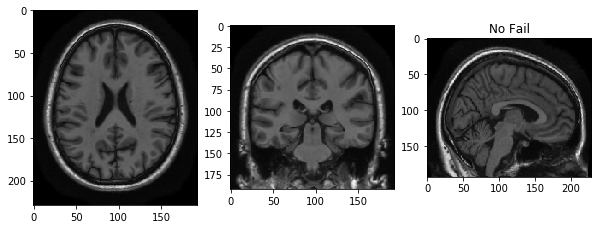

027_S_0404/Baseline Distance from template: 4056.0839342 ###


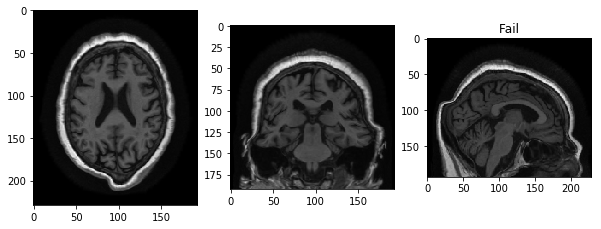

027_S_0404/Month12 Distance from template: 2394.79212366 


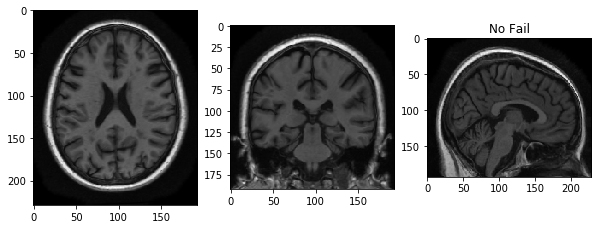

027_S_0404/Month24 Distance from template: 4218.04625709 ###


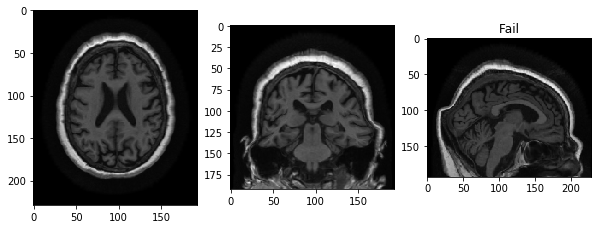

126_S_0606/Baseline Distance from template: 1702.85558869 


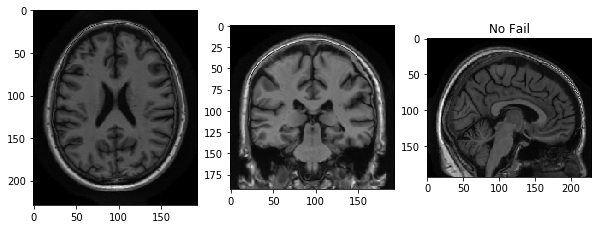

126_S_0606/Month12 Distance from template: 1575.27608191 


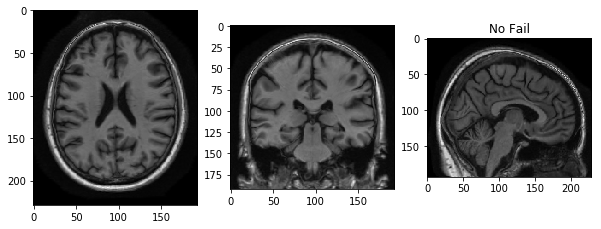

126_S_0606/Month24 Distance from template: 1611.36541439 


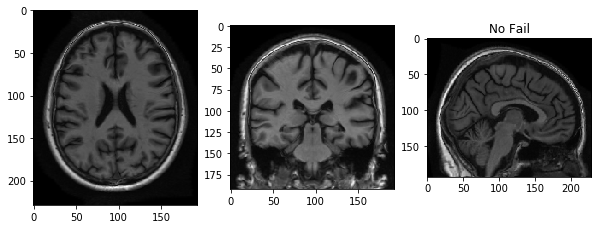

027_S_1385/Baseline Distance from template: 2376.4491006 


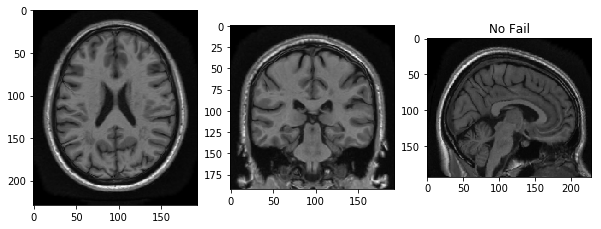

027_S_1385/Month12 Distance from template: 4334.91884483 ###


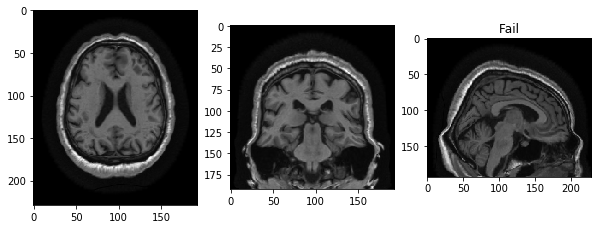

027_S_1385/Month24 Distance from template: 2308.85329889 


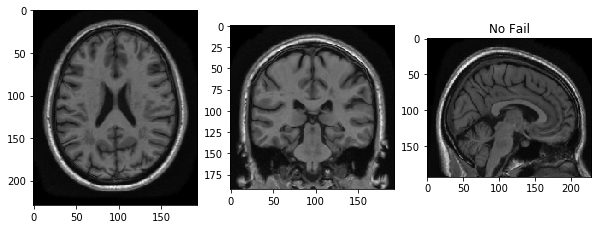

027_S_0403/Baseline Distance from template: 1433.52136608 


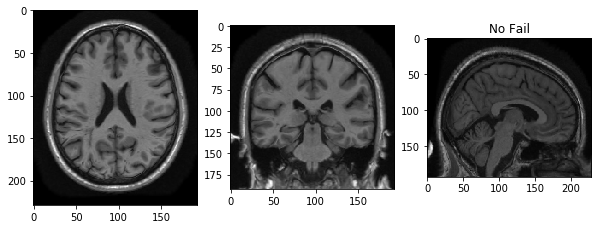

027_S_0403/Month12 Distance from template: 1614.59293328 


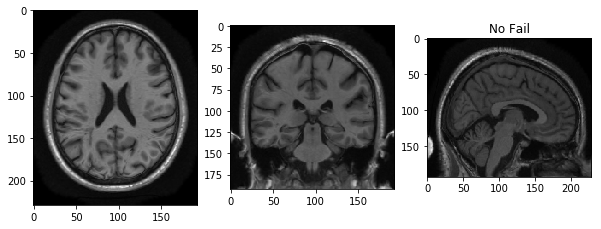

027_S_0403/Month24 Distance from template: 1728.38755825 


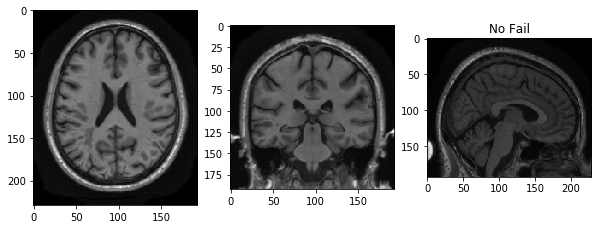

136_S_0184/Baseline Distance from template: 1928.76025253 


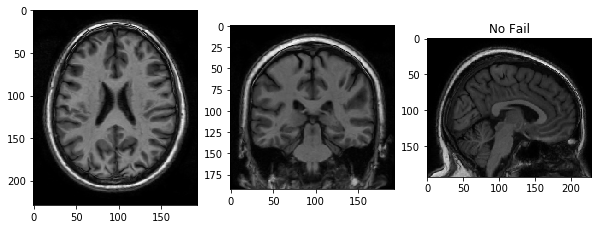

136_S_0184/Month12 Distance from template: 1648.16100997 


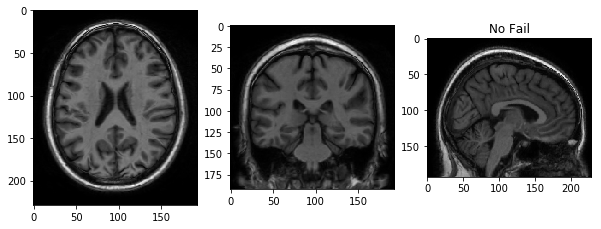

136_S_0184/Month24 Distance from template: 2081.20679151 


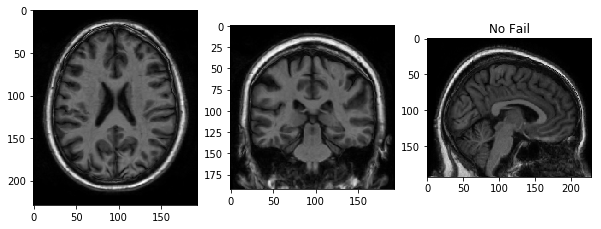

018_S_0633/Baseline Distance from template: 2000.46297504 


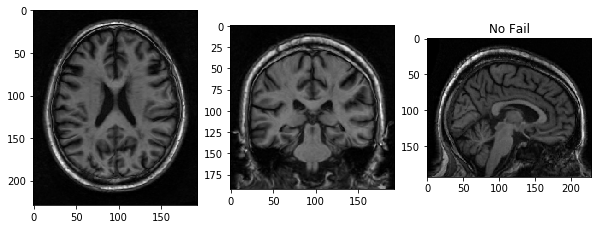

018_S_0633/Month12 Distance from template: 2796.77190704 ###


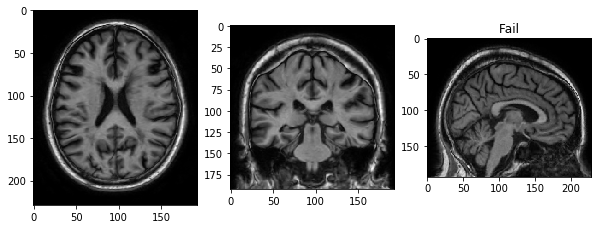

018_S_0633/Month24 Distance from template: 2557.63995636 


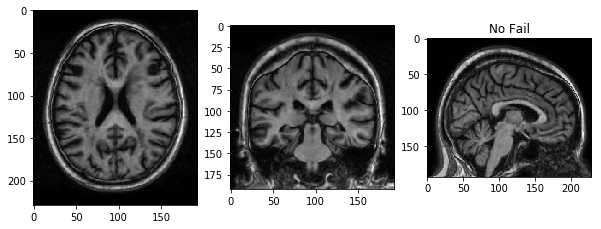

027_S_1081/Baseline Distance from template: 2389.65965466 


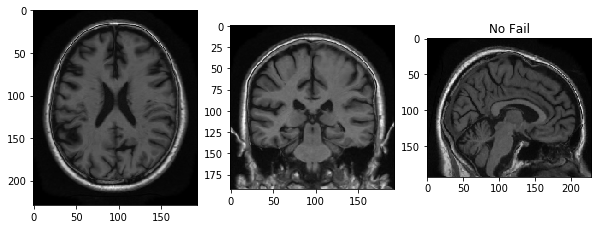

027_S_1081/Month12 Distance from template: 2717.92095298 ###


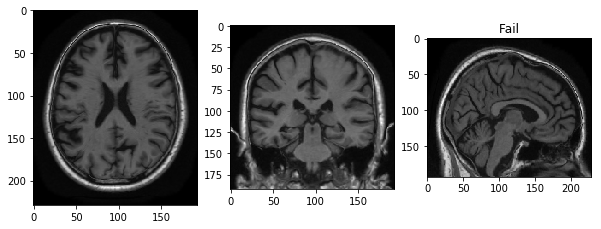

027_S_1081/Month24 Distance from template: 2507.20513217 


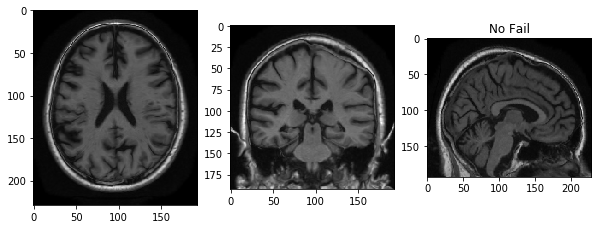

023_S_0376/Baseline Distance from template: 1789.2798138 


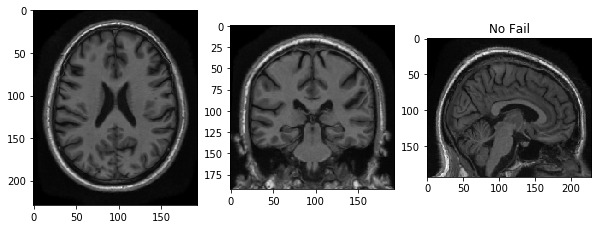

023_S_0376/Month12 Distance from template: 3549.51828457 ###


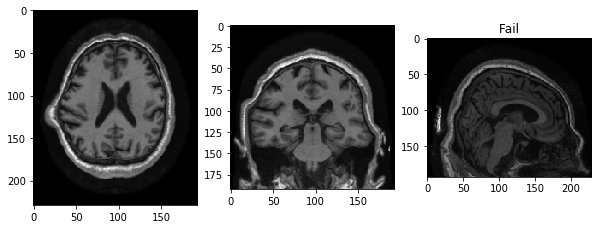

023_S_0376/Month24 Distance from template: 2284.07900234 


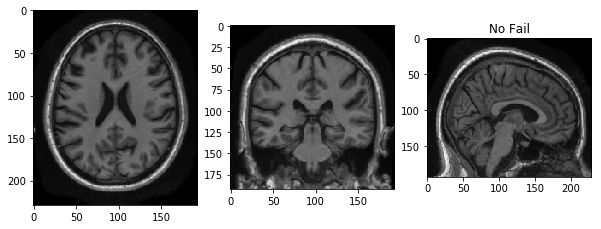

067_S_0607/Baseline Distance from template: 2500.83332902 


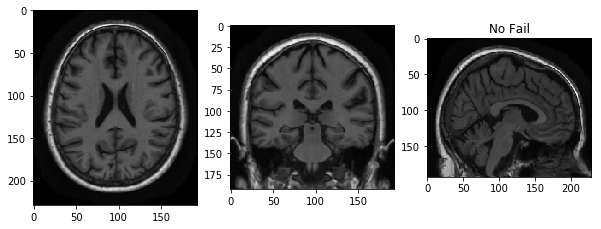

067_S_0607/Month12 Distance from template: 1755.54521865 


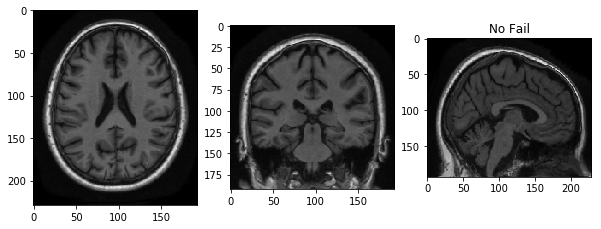

067_S_0607/Month24 Distance from template: 2317.94034461 


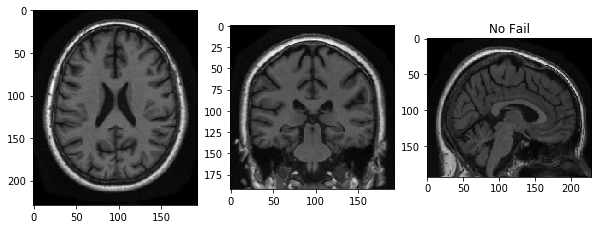

023_S_0030/Baseline Distance from template: 3929.8830805 ###


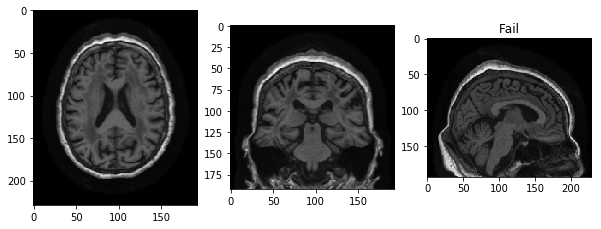

023_S_0030/Month12 Distance from template: 1572.52045413 


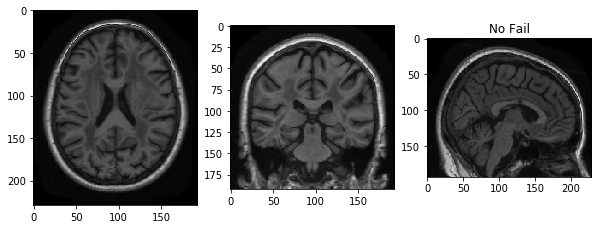

023_S_0030/Month24 Distance from template: 4411.14383214 ###


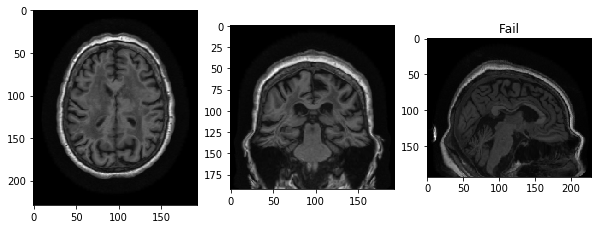

002_S_0413/Baseline Distance from template: 1666.53946503 


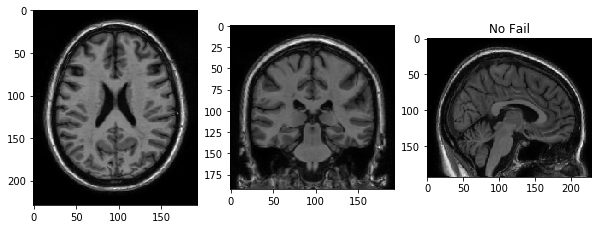

002_S_0413/Month12 Distance from template: 1715.73973231 


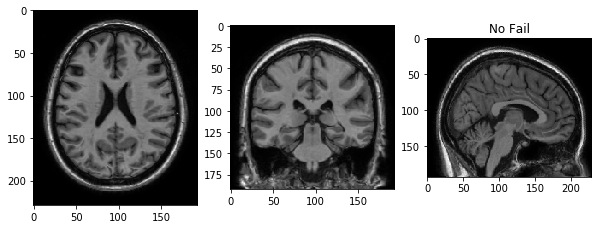

002_S_0413/Month24 Distance from template: 1606.99564557 


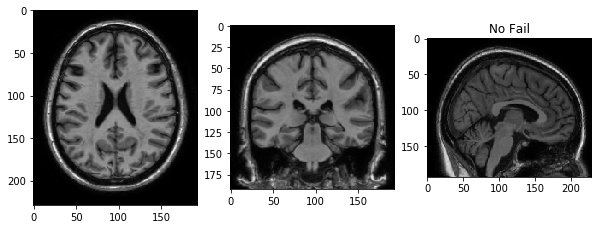

023_S_1262/Baseline Distance from template: 2616.13022833 


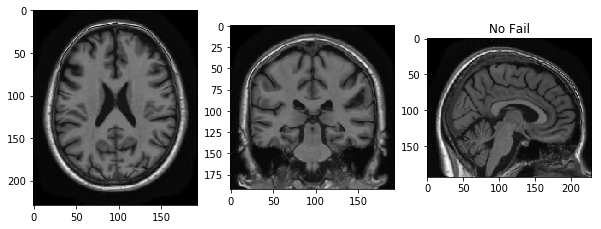

023_S_1262/Month12 Distance from template: 2449.96929364 


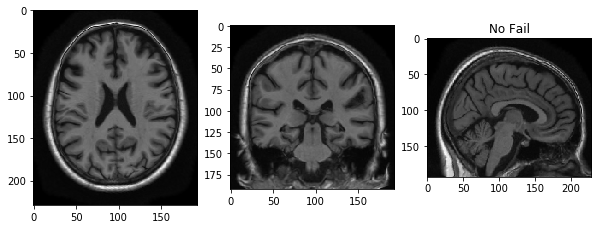

023_S_1262/Month24 Distance from template: 1530.46419534 


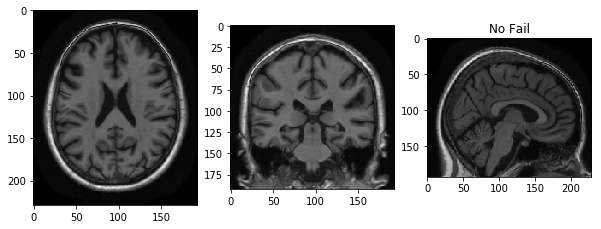

023_S_0604/Baseline Distance from template: 1927.13253217 


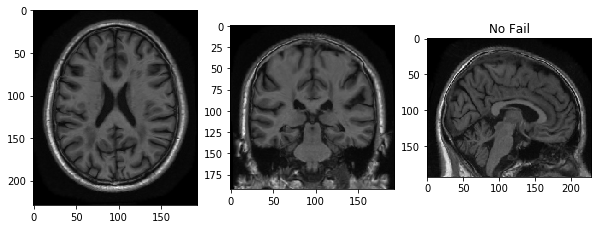

023_S_0604/Month12 Distance from template: 2077.92356919 


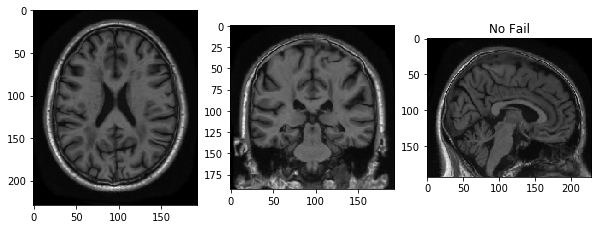

023_S_0604/Month24 Distance from template: 1920.10486199 


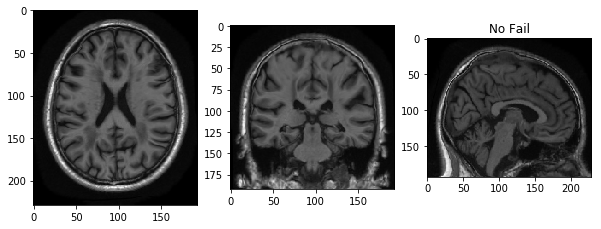

100_S_0015/Baseline Distance from template: 2097.09811064 


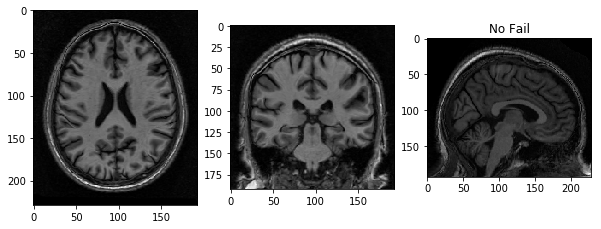

100_S_0015/Month12 Distance from template: 2406.78079791 


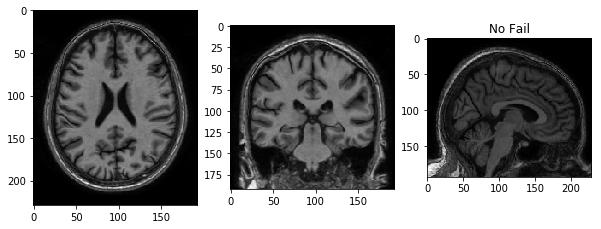

100_S_0015/Month24 Distance from template: 1672.87321946 


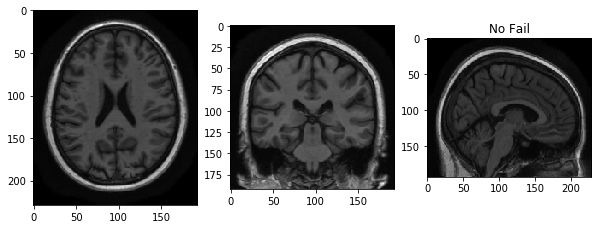

005_S_0814/Baseline Distance from template: 1670.33986309 


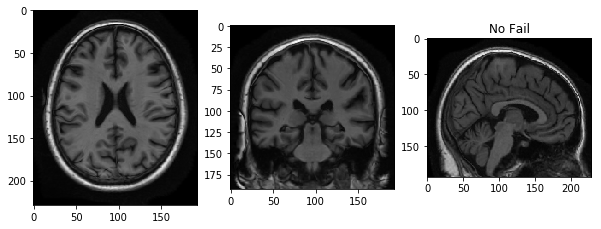

005_S_0814/Month12 Distance from template: 2358.83413173 


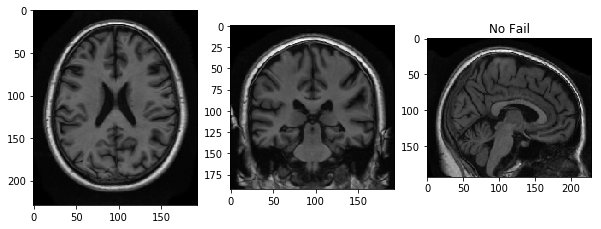

005_S_0814/Month24 Distance from template: 1848.17033276 


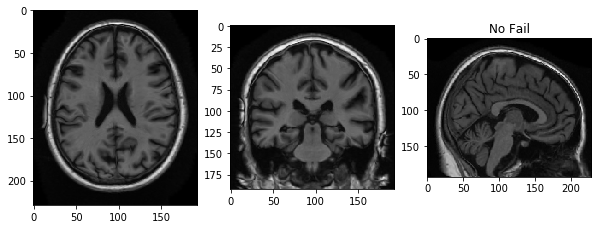

023_S_0625/Baseline Distance from template: 2188.38366612 


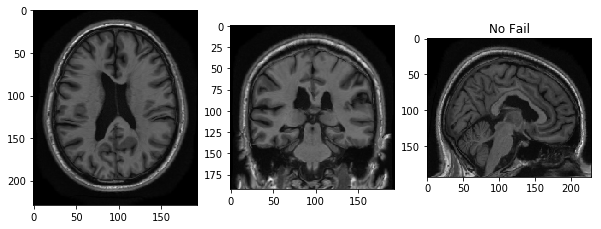

023_S_0625/Month12 Distance from template: 2653.86044295 ###


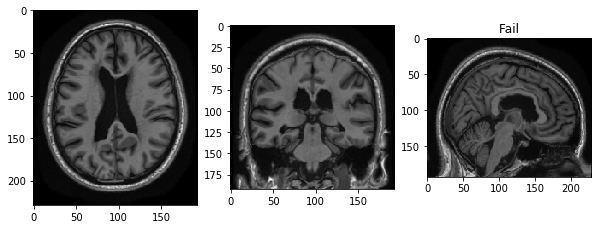

023_S_0625/Month24 Distance from template: 2434.52612556 


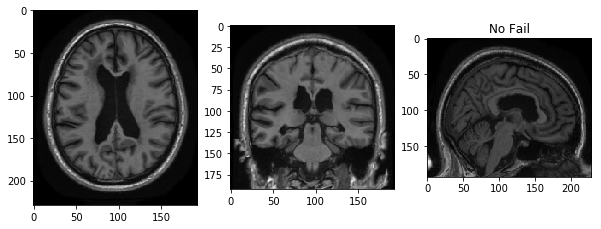

136_S_0300/Baseline Distance from template: 2425.47173884 


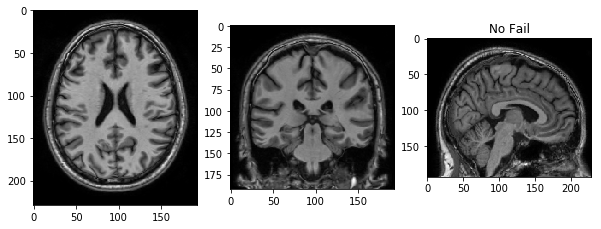

136_S_0300/Month12 Distance from template: 2458.38559954 


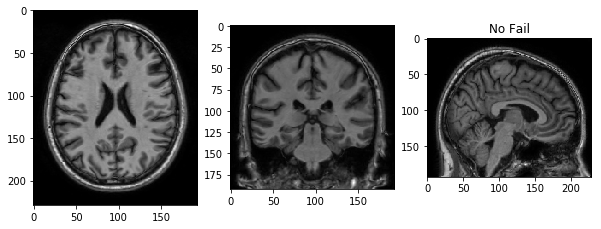

136_S_0300/Month24 Distance from template: 1716.31971498 


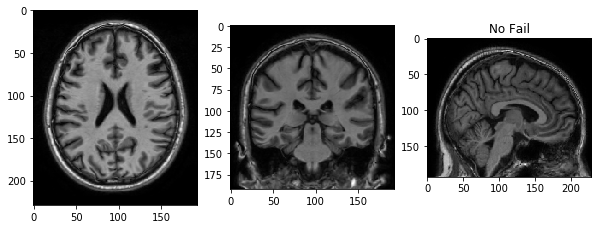

002_S_1268/Baseline Distance from template: 1674.86468928 


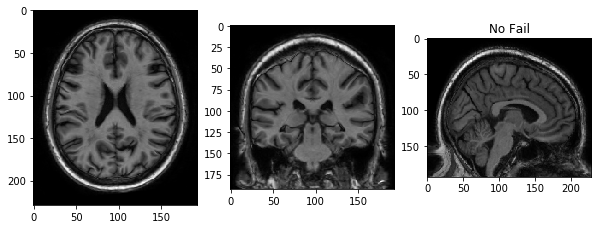

002_S_1268/Month12 Distance from template: 1835.15477421 


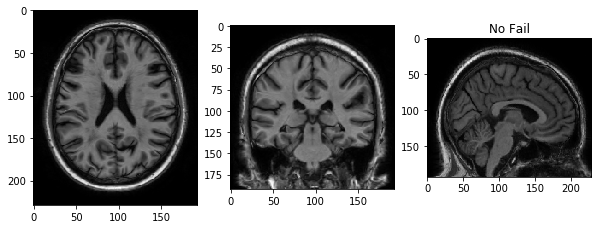

002_S_1268/Month24 Distance from template: 1634.25135208 


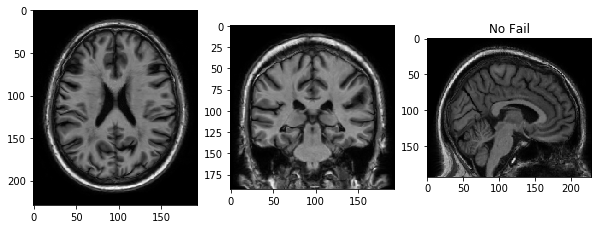

023_S_1247/Baseline Distance from template: 3013.38683301 ###


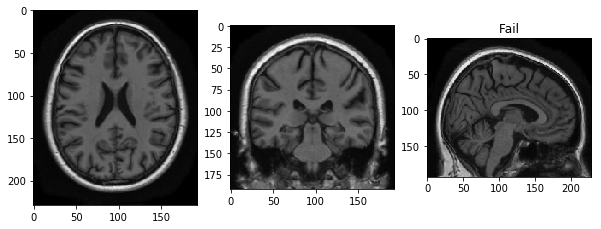

023_S_1247/Month12 Distance from template: 3050.49307312 ###


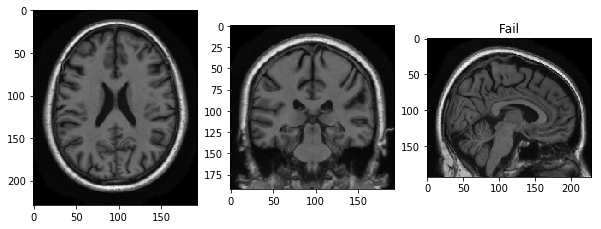

023_S_1247/Month24 Distance from template: 2531.21291228 


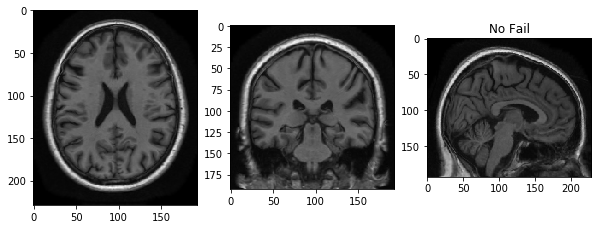

100_S_1286/Baseline Distance from template: 1859.7767229 


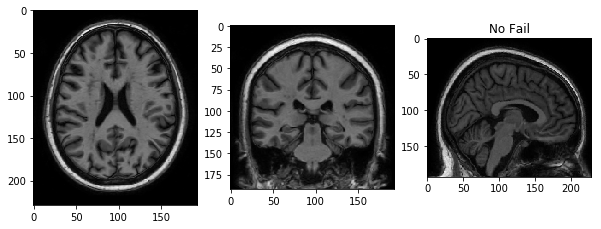

100_S_1286/Month12 Distance from template: 1793.57313726 


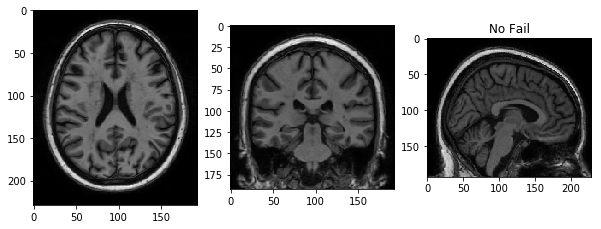

100_S_1286/Month24 Distance from template: 2620.55999701 


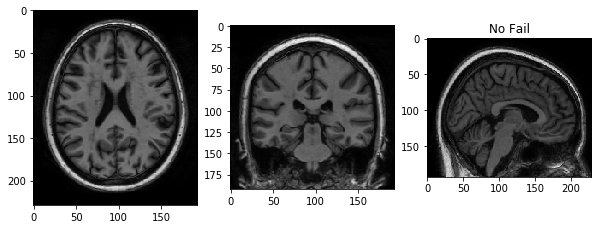

051_S_1331/Baseline Distance from template: 1864.93634933 


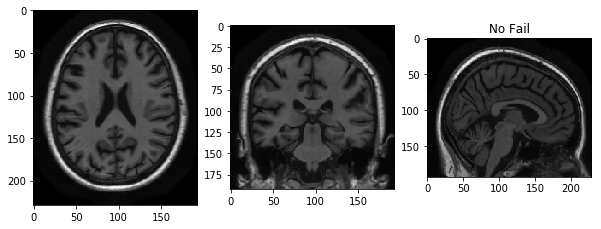

051_S_1331/Month12 Distance from template: 1975.20900045 


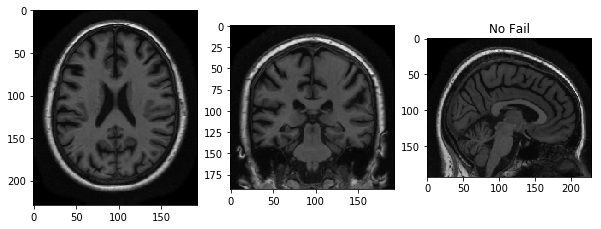

051_S_1331/Month24 Distance from template: 2028.14013093 


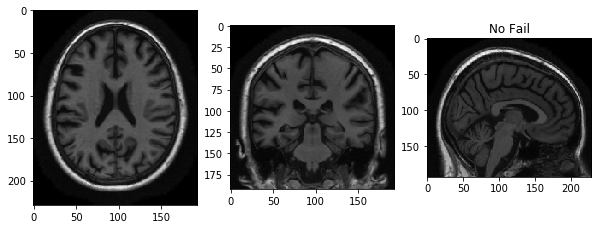

130_S_0956/Baseline Distance from template: 2089.80167739 


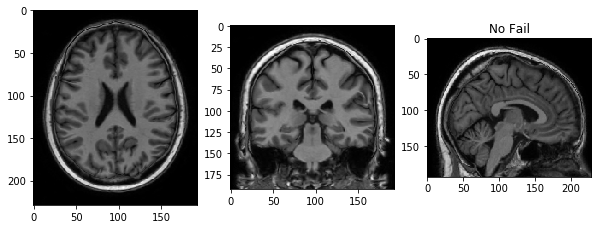

130_S_0956/Month12 Distance from template: 2405.38833236 


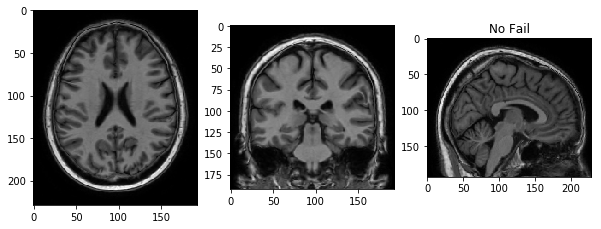

130_S_0956/Month24 Distance from template: 1819.74839954 


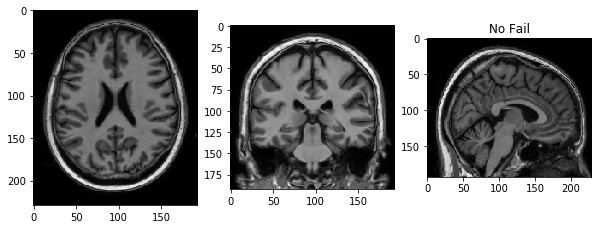

116_S_1249/Baseline Distance from template: 2541.74069519 


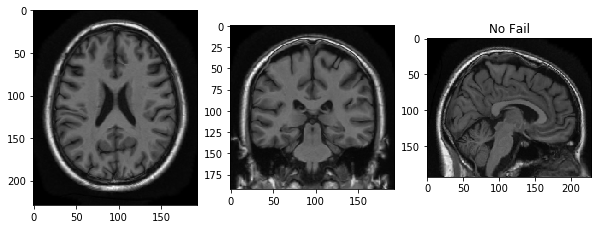

116_S_1249/Month12 Distance from template: 1448.98535343 


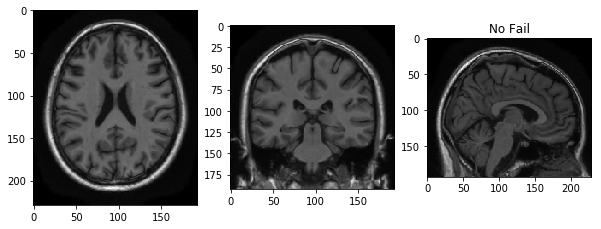

116_S_1249/Month24 Distance from template: 1432.81906158 


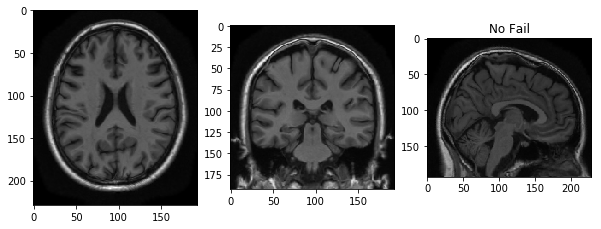

126_S_0605/Baseline Distance from template: 1456.00706283 


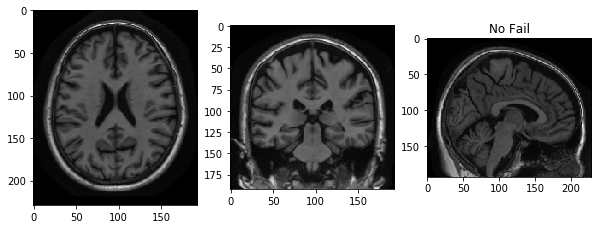

126_S_0605/Month12 Distance from template: 2064.11272669 


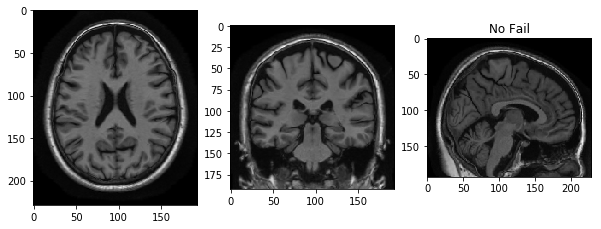

126_S_0605/Month24 Distance from template: 1951.53289454 


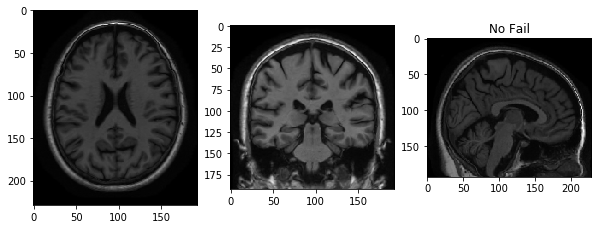

023_S_0916/Baseline Distance from template: 2524.10028184 


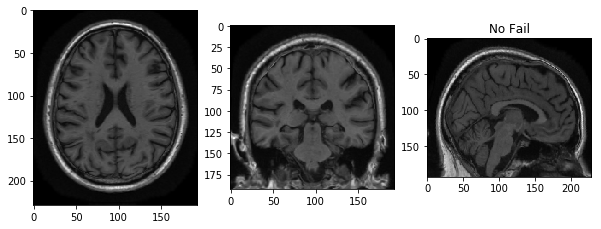

023_S_0916/Month12 Distance from template: 2076.81941681 


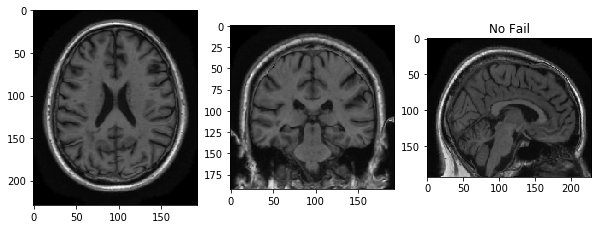

023_S_0916/Month24 Distance from template: 1694.59113197 


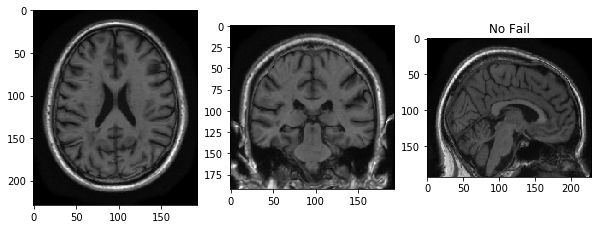

027_S_1082/Baseline Distance from template: 2219.13268107 


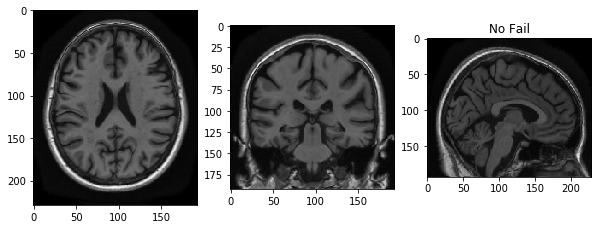

027_S_1082/Month12 Distance from template: 2127.44187256 


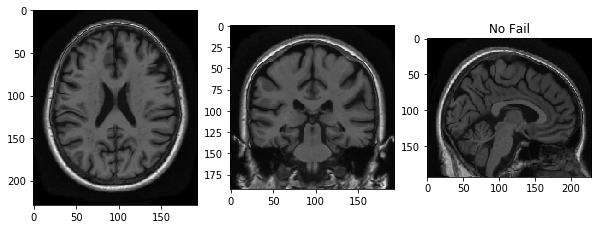

027_S_1082/Month24 Distance from template: 3998.34510123 ###


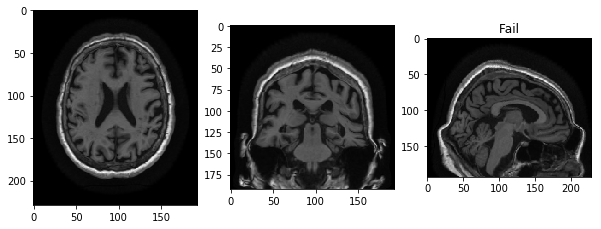

032_S_1169/Baseline Distance from template: 2051.24077243 


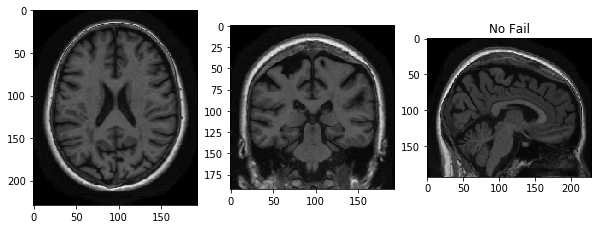

032_S_1169/Month12 Distance from template: 2050.94771752 


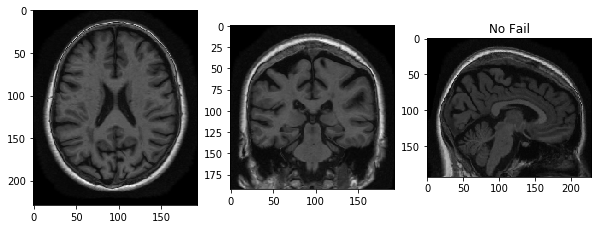

032_S_1169/Month24 Distance from template: 1917.00644579 


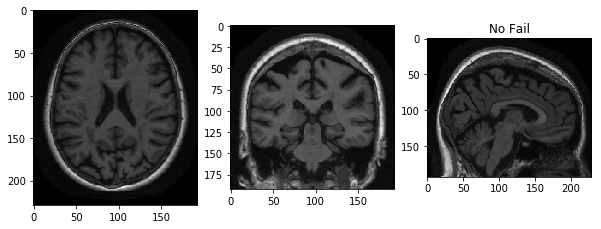

005_S_0553/Baseline Distance from template: 1474.14464995 


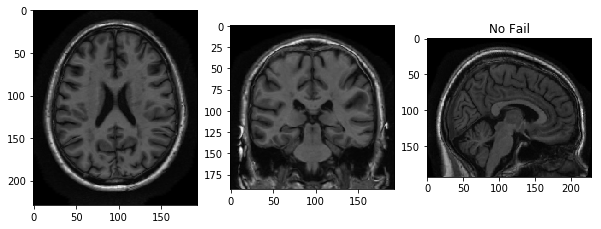

005_S_0553/Month12 Distance from template: 2341.00312992 


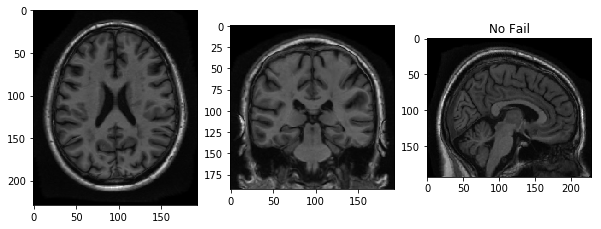

005_S_0553/Month24 Distance from template: 1671.25269291 


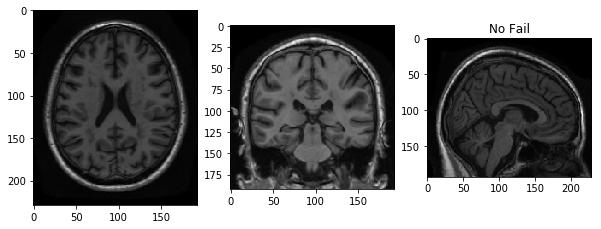

130_S_0969/Baseline Distance from template: 2316.42097803 


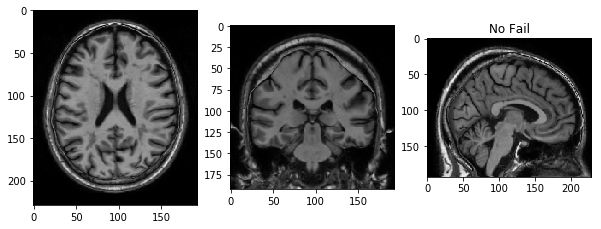

130_S_0969/Month12 Distance from template: 2278.96942482 


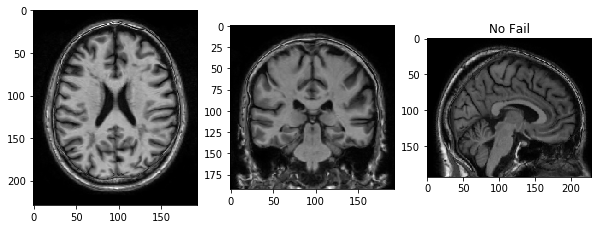

130_S_0969/Month24 Distance from template: 1953.74883222 


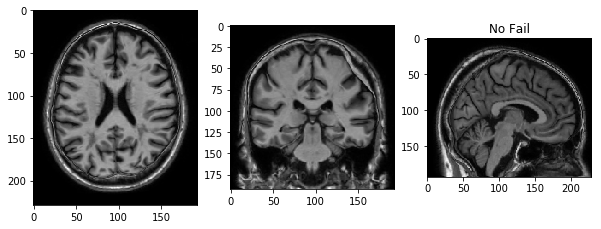

136_S_0429/Baseline Distance from template: 1634.95988661 


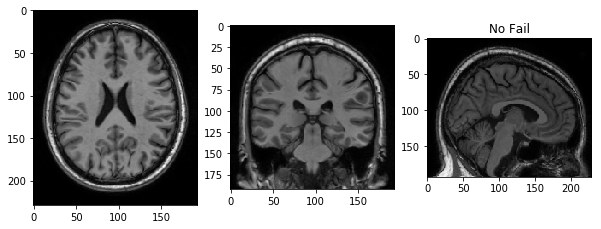

136_S_0429/Month12 Distance from template: 1475.48175547 


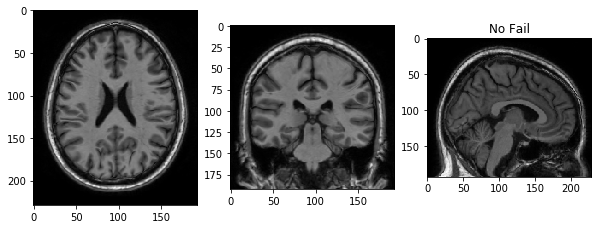

136_S_0429/Month24 Distance from template: 1643.65517716 


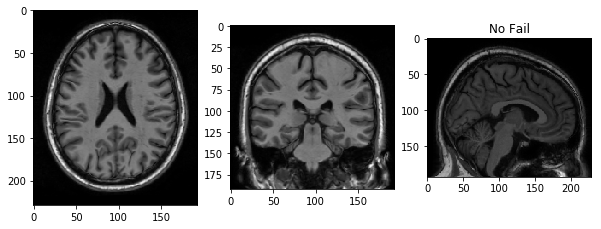

130_S_0449/Baseline Distance from template: 2031.46870566 


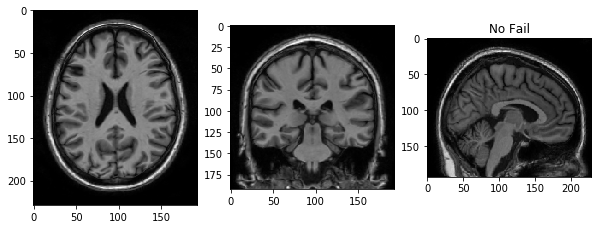

130_S_0449/Month12 Distance from template: 1693.52289388 


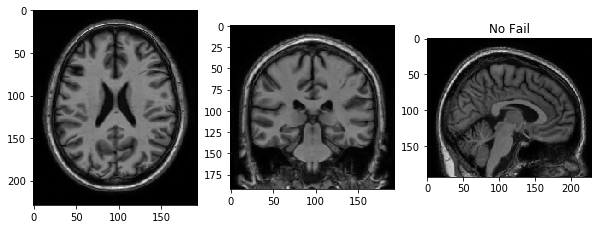

130_S_0449/Month24 Distance from template: 1553.84385666 


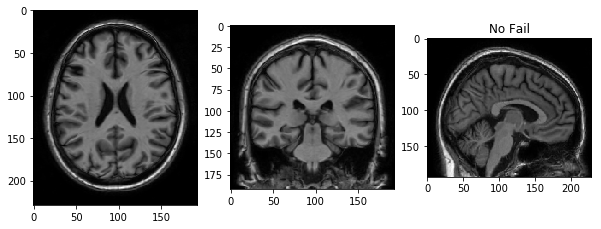

007_S_1222/Baseline Distance from template: 1874.59853049 


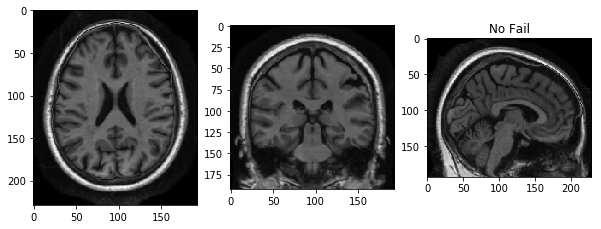

007_S_1222/Month12 Distance from template: 2134.17136438 


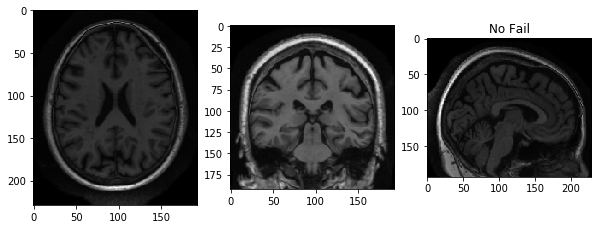

007_S_1222/Month24 Distance from template: 2060.55257252 


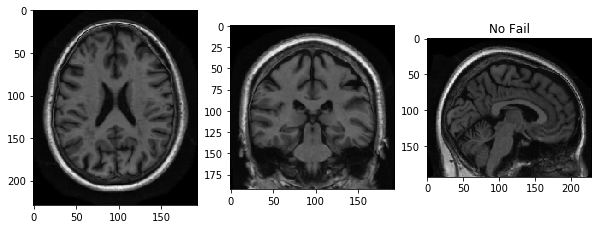

031_S_1066/Baseline Distance from template: 2445.13856032 


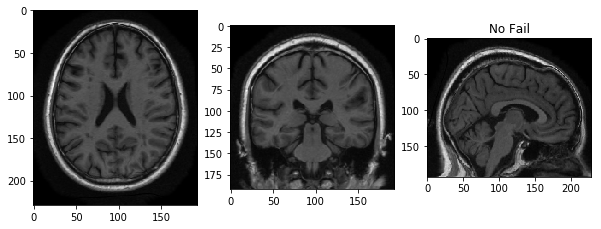

031_S_1066/Month12 Distance from template: 2835.40670206 ###


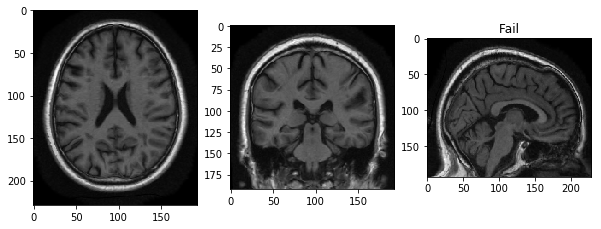

031_S_1066/Month24 Distance from template: 2303.05033234 


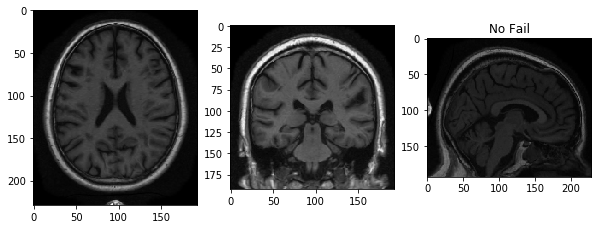

116_S_0487/Baseline Distance from template: 1487.17243829 


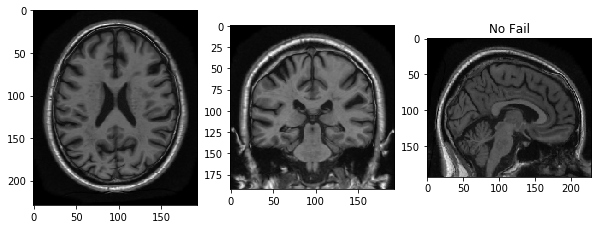

116_S_0487/Month12 Distance from template: 2737.18647387 ###


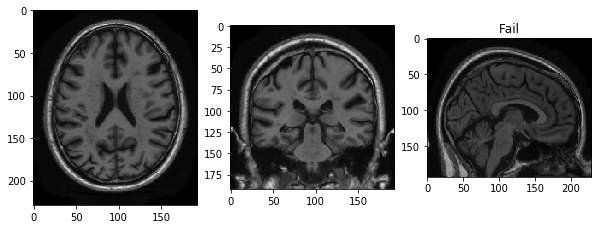

116_S_0487/Month24 Distance from template: 2639.54421664 


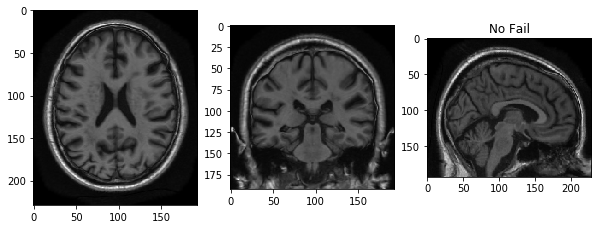

018_S_0335/Baseline Distance from template: 1801.24508874 


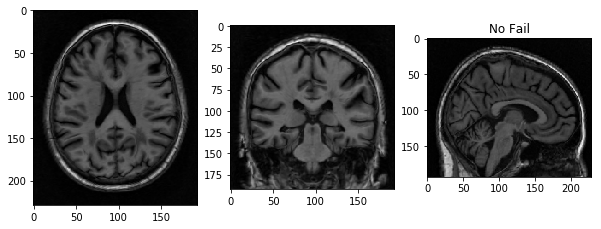

018_S_0335/Month12 Distance from template: 1576.59629565 


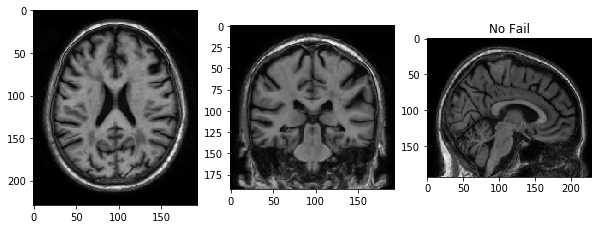

018_S_0335/Month24 Distance from template: 1533.5534382 


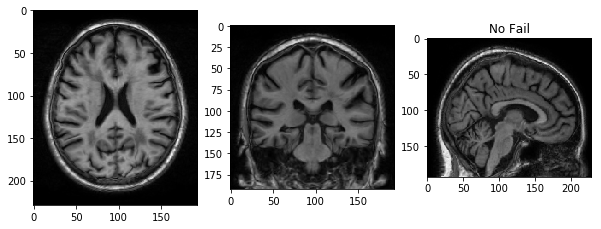

023_S_0388/Baseline Distance from template: 1991.7184596 


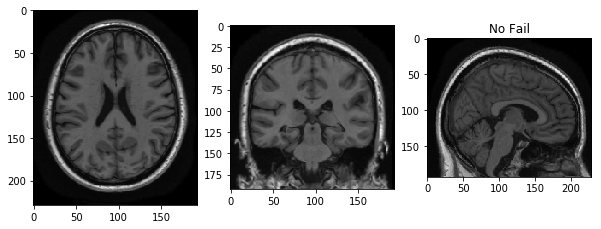

023_S_0388/Month12 Distance from template: 1936.56259631 


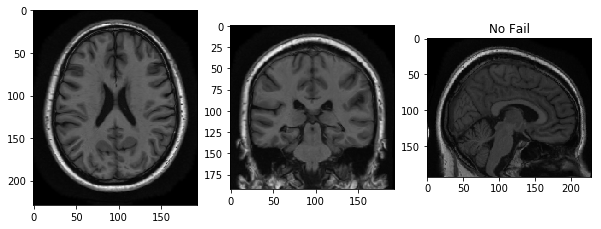

023_S_0388/Month24 Distance from template: 1968.27178694 


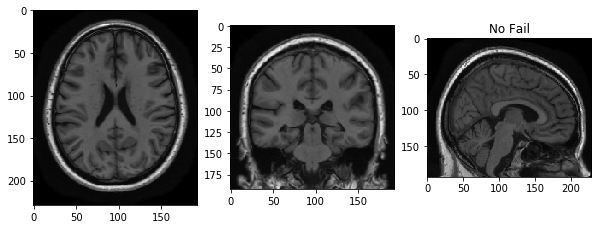

018_S_0450/Baseline Distance from template: 3891.16701408 ###


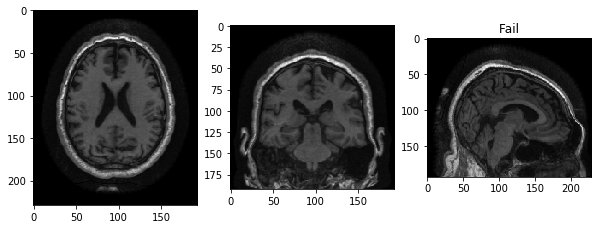

018_S_0450/Month12 Distance from template: 2005.05790184 


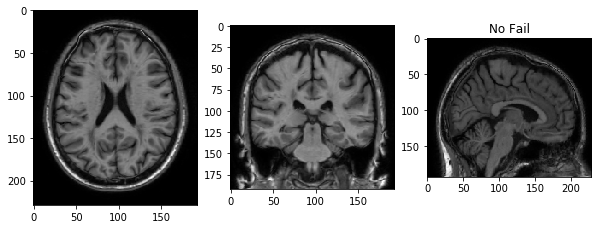

018_S_0450/Month24 Distance from template: 1800.72818812 


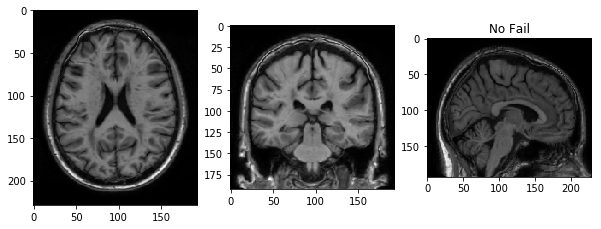

012_S_0689/Baseline Distance from template: 1933.54763661 


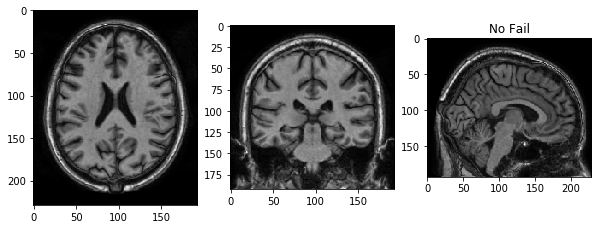

012_S_0689/Month12 Distance from template: 2375.66165812 


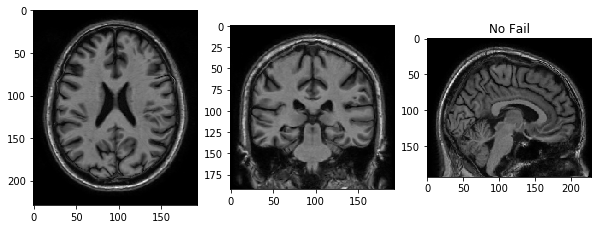

012_S_0689/Month24 Distance from template: 1802.73140973 


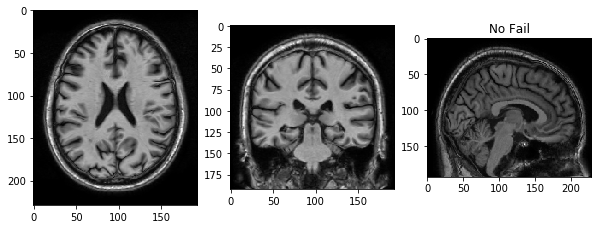

018_S_0369/Baseline Distance from template: 1772.19361068 


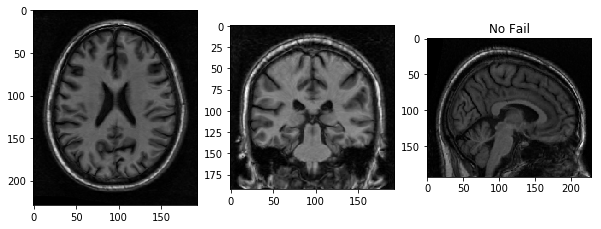

018_S_0369/Month12 Distance from template: 1517.97712011 


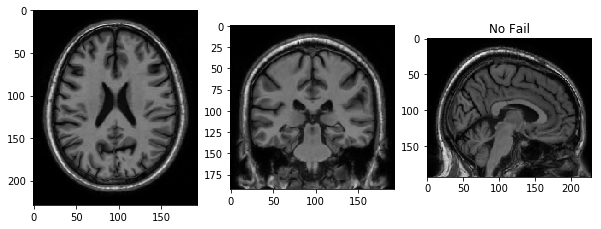

018_S_0369/Month24 Distance from template: 1595.71984524 


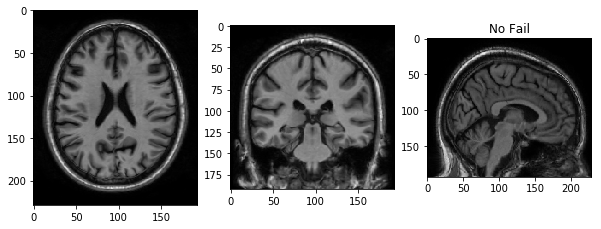

002_S_1018/Baseline Distance from template: 1578.05961791 


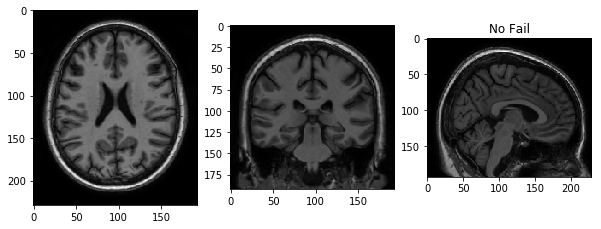

002_S_1018/Month12 Distance from template: 1544.72781126 


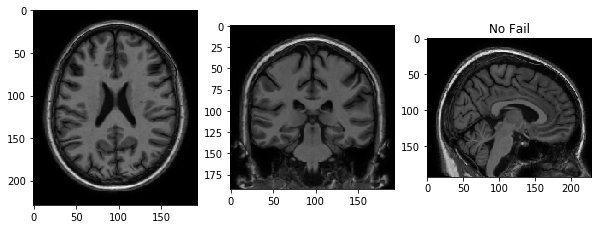

002_S_1018/Month24 Distance from template: 1551.33085638 


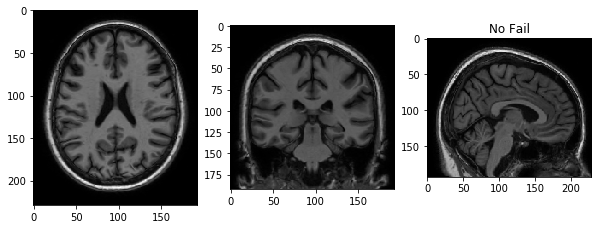

002_S_1261/Baseline Distance from template: 1610.73679952 


KeyboardInterrupt: 

In [107]:
print("Calculating scan norms..")
# Compute norm for each scan and highlight if above threshold
thresh = 3000 # current best for /preprocessed_alt/ = 3000; for /preprocessed/ = 650
compute_norms(avg_scan, thresh, z_slice=100)